<h1 align="center"><strong><font size="6"> The Soccer-Factor-Model <br> Identifying a Soccer-Player's Skill/Ability via Bayesian Logistic Regression </h1></strong></font>

(Actually, it's football, the *jogo bonito* that you play with your feet. But oddly, Americans call it *soccer*.)

Welcome to the notebook hosting the **Soccer-Factor-Model** (SFM). Before jumping into a short introduction into what the SFM actually is, I would like to make a few remarks upfront:

1. The SFM is not confined to soccer only, but can easliy be adpated to all kinds of other sports: football, baseball, basketball, Formula 1, etc. The only requirement: **data on individual players and/or teams**.

2. The model itself is implemented with the enormous help of **[#PyMC](https://www.pymc.io/welcome.html)**.

3. Given that **[#PyMC](https://www.pymc.io/welcome.html)** thankfully does all the heavy work, the actual **star** of the analysis is not the model construction and estimation, but rather the data/feature engineering part.

## Pre-Game Ramblings

### What's the Soccer-Factor-Model all about?

#### The Inspiration

The Soccer-Factor-Model (SFM) is inspired by the academic literature on asset-pricing along the following lines:

> 1. Factor Models à la [Fama & French](https://onlinelibrary.wiley.com/doi/full/10.1111/j.1540-6261.1992.tb04398.x) use "factors" to explain the cross-section of stock returns. <br>
 --> **here**: we use "Team-Factors" to explain away the role of the team's strength in making a given player $i$ score a goal.

> 2. There is some literature on the skill of investment fund managers that works in a similar way: "explain away" that proportion of a fund's returns that is related to economic fundamentals (e.g. [Coggin, Fabozzi, Rahman (1993)](https://onlinelibrary.wiley.com/doi/10.1111/j.1540-6261.1993.tb04029.x); [Fama & French (2010)](https://onlinelibrary.wiley.com/doi/10.1111/j.1540-6261.2010.01598.x); [Berg & van Binsbergen (2015)](https://www.sciencedirect.com/science/article/pii/S0304405X15000628)):
\begin{align}
  r_{p,t} = \alpha_p + \sum^N_{n=1} \beta_n \, f_{n,t} + \varepsilon_{p,t}
\end{align} <br>
 where $r_{p,t}$ is portfolio $p$'s return in excess of the risk-free rate (e.g. short-term U.S. government bonds). $f_{n,t}$ measures the return that one could generate by following the strategy prescribed by **factor $n$**, and $\varepsilon_{p,t}$ is a random error that is usually assumed to be mean zero. <br> The parameter of interest here is $\mathbf{\alpha_p}$. It is that part of a portfolio's conditional mean, that is not to be explained by the factors $f_{1,t},...,f_{N,t}$, and is a measure of the portfolio manager's **skill/ability**. Said differently: it quantifies the manager's ability to generate returns **beyond** the return you would have received by just following the investment strategy dictated by the factors.

#### From Asset-Pricing to Soccer

In our case, the "dependent variable"/"label"/"outcome variable" ($y_{i,s,m}$) will be a binary indicator, telling us whether player $i$ has scored a goal (or not) in season $s$ in match $m$:

\begin{align}
        y_{i,s,m} = \left\{
        \begin{array}{cl}
        0 & \textbf{not} \text{ scored} \\
        1 & \text{scored}
        \end{array}
        \right.
\end{align}

> *Sidenote*: This binary classification exercise is just a way to keep things simple. One may also want to predict the *number* of goals in a given match, which would make it for a multiclass extension.

The SFM is then set-up as follows:

\begin{align}
     p_{i,s,m} \equiv   P\left(y_{i,s,m} = 1 | \mathbf{x}_{i,s,m-1}, \alpha_i, \beta \right) = \sigma \left(\alpha_{i} + \mathbf{x}_{i,s,m-1} \, \mathbf{\beta} \right) \qquad \left( M.1 \right)
\end{align}

where:

> - $p_{i,s,m}$: &ensp;&ensp;&emsp; The probability of player $i$ scoring a goal in season $s$ in match $m$ *conditional* on $\mathbf{x}_{i,s,m-1}$, $\alpha_i$, and $\beta \;$ ;

> - $\mathbf{x}_{i,s,m-1}$: &emsp; A $\; 1 \times N$ vector of *factors* that are intended to resemble the imbalance between player $i$'s team and the <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; opponent-team. The subscript $m-1$ signals that these *factors* only contain information about the teams' <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; differences that prevail **before** the referee blows the whistle to start off match $m$ ! <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; Again, to be clear, these *factors* are intended to explain that fraction of $p_{i,s,m}$ that is due to the difference in the <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; strength  of player $i$'s team and the opponent-team;

> - $\beta$: &ensp;&ensp;&ensp;&ensp;&ensp;&emsp; The sensitivity of $p_{i,s,m}$ to the factors $\mathbf{x}_{i,s,m} \;$;

> - $\alpha_i$: &ensp;&ensp;&ensp;&ensp;&ensp; Our main parameter of interest as it captures that fraction of $p_{i,s,m}$ that is attributed to player $i$'s skill/ability only! <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; (Yes, later on, this parameter will carry a subscript $s$, $\alpha_{i,s} \;$, allowing a player's skill/ability to vary across seasons);

> - $\sigma \left(\cdot\right)$: &ensp;&ensp;&emsp; The $\mathtt{sigmoid}$ function, which transforms the predictions of the linear model $\alpha_i + \mathbf{X}_i \, \mathbf{\beta}$ into a number that <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; ranges between zero and one, such that $p_{i,s,m} \in \left[0;1\right]$.

Just for notational convenience, we will re-write Equation ($M.1$) to get rid off the subscripts $s$ and $m$:

\begin{align}
     p_{i} \equiv   P\left(Y_{i} = 1 | \mathbf{X}_{i}, \alpha_i, \beta \right) = \sigma \left(\alpha_{i} + \mathbf{X}_{i} \, \mathbf{\beta} \right) \qquad \left( 1 \right )
\end{align}

where now:

> - $Y_{i}$: &ensp;&ensp;&ensp;&ensp;&ensp; A $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times 1$ vector of zeros and ones,
> - $\mathbf{X}_i$: &ensp;&ensp;&ensp;&ensp;&emsp; A $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times N$ matrix of *factors*
> > where
> > - $S_i$:  &ensp;&ensp;&ensp; The total number of seasons player $i$ has played,
> > - $M_{i,s}$: &ensp; The total number of matches played by player $i$ in season $s$.
> - $p_{i}$: &ensp;&ensp;&ensp;&ensp;&ensp; With a slight abuse of notation, a $\; \left(\sum^{S_i}_{s=1} M_{i,s}\right) \times 1$ vector of probabilities, with $p_{i} \in \left[0;1\right]$.

<br>

<font color='darkred'>**IMPORTANT**</font>: &emsp; The explanatory variables (*factors*, $\mathbf{X}_i$) describe the *state* that had persisted **before** a given match $m$ was played.  <br>
&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; E.g., when we observe $y_{i,s,m}$, the *factors* will only capture information that was available to us **prior to** match $m$! <br>
&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp; Therefore, we will have the following mapping: $y_{i,s,m} \rightarrow \mathbf{x}_{i,s,m-1}$.

### Factors: The Heart of the SFM

Factors are intended to help us understand which part of $p_i$ is due to the strength of the **team** ( $\mathbf{X}_i \, \mathbf{\beta}$ ) that player $i$ is playing for, and which proportion of $p_i$ is due to player $i$'s **own** ($\alpha_i$) skill/ability. In that sense, $\alpha_i$ is our main parameter of interest as it gives us a measure of the **skill/ability** of player $i$ to score a goal.

<font color='darkred'>**NOTE**</font>: &emsp; Hard-core finance academics might be outraged with me making a comparison between the SFM-factors ($\mathbf{x}_{i,s,m-1}$) that I introduce below, and the **true** asset-pricing factors ($f_t$) mentioned above.
One reason is that the SFM-factors carry an additional subscript $i$, which indicates that these factors vary across teams or even across players. In contrast, the traditional asset-pricing factors are only varying across time, but are *invariant* across entities.

### Factor Engineering

The number of *factors* we can build and their informative value, depends obviously on the data that is available to us. For the following exercise, I depend on publicly available data free of charge. That is already a limitation for producing a meaningful model.

However, I guess I found a decent dataset, which I pulled from [#Kaggle](https://www.kaggle.com/datasets/marclamyhshshs/premier-league-games?select=clean_players_info.csv).
All credits for that dataset go to [Marc Lamyhshshs](https://www.kaggle.com/marclamyhshshs).
It comprises all Premier League matches since 1992, which allows us to look at some very, very, very interesting players!

The amount of data is surely impressive! This allows us to create some interesting *factors*.

To showcase how SFM works, I chose to construct the following ones:

- `goalsscored_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The current difference of *goals scored* by player $i$'s team and the opponent-team
- `goalsscored_rank_team`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The current ranking of player $i$'s team in *goals scored*
- `goalsscored_rank_team_wo_player`: &emsp; The current ranking of player $i$'s team in *goals scored*, not accounting for <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; the number of goals scored by player $i$
- `goalsconceded_rank_opp`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp; The current ranking of the opponent-team in *goals conceded*
- `points_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; The difference in points of the player's team and the opponent
- `goal_balance_team`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between *goals scored* and *goals conceded* of the team which <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; our player of interest is playing for
- `goal_balance_opp`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between *goals scored* and *goals conceded* of the opponent-team which <br> &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&emsp;&emsp; our player of interest is playing against in match $m$
- `goal_balance_diff`: &ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp;&ensp; The difference between `goal_balance_team` and `goal_balance_opp`

Throughout the notebook, I attached some questions about whether a given factor is actually related to team-effort or actually an indication of a player's strength. If the latter were true, we should exclude that particular factor as our model would be mis-specified! Or we would just hope that the posterior of the corresponding loading is centered around zero with only little variance...

<font color='darkred'>**Lastly:**</font> This list of factors is by no means comprehensive and much more creative minds might already have thought of many more fancy factors to build from the underlying data.
Feel free to build your own factors! Data on `shots_home` and `shots_away` sound to have potential to form other interesting explanatory variables that I haven't included yet!

## Data preparation

In [1]:
import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymc as pm
import pytensor.tensor as pt
import seaborn as sns
import xarray as xr
from matplotlib.lines import Line2D

In [2]:
az.style.use("arviz-whitegrid")
plt.rcParams["figure.figsize"] = [12, 5]
%config InlineBackend.figure_format = 'retina'
seed = sum(map(ord, "sfm"))
rng = np.random.default_rng(seed)

In [3]:
RLPs = pd.Index(
    [
        "harry kewell",
        "jermain defoe",
        "nicolas anelka",
        "robbie fowler",
        "robbie keane",
        "robert pires",
    ],
).sort_values()

factors = [
    "goalsscored_rank_team",
    "goalsscored_rank_team_wo_player",
    "home_pitch",
    "goalsconceded_rank_opp",
    "points_diff",
    "goal_balance_diff",
]

In [4]:
complete_data = pd.read_csv("../../10_data/101_SFM/SFM_data.csv")

complete_data["goal"] = complete_data["goal"].astype(int)
complete_data["kickoff_dt"] = pd.to_datetime(
    complete_data["kickoff_dt"], yearfirst=True
)

# compute season number for each player, ~maturity of player
complete_data["season_nbr"] = complete_data.groupby(["name_player"])[
    "season"
].transform(lambda x: x.factorize(sort=True)[0])

# compute days since first game of the season for each player
# aka within-season effects
complete_data["days_since_first_game"] = complete_data.groupby(
    ["name_player", "season"]
)["kickoff_dt"].transform(lambda x: (x - x.min()).dt.days)

complete_data["goals_in_match"] = complete_data["goals_in_match"].astype(int)
complete_data = complete_data.sort_values(["name_player", "kickoff_dt"]).reset_index(
    drop=True
)
complete_data["is_rlp"] = complete_data.name_player.isin(RLPs).astype(int)
players = pd.factorize(complete_data["name_player"], sort=True)[1]
players_ordered = players.difference(RLPs).append(RLPs)

complete_data

,goal,goals_in_match,points_team,points_opp,goalsscored_cum_team,goalsscored_cum_opp,goalsconceded_cum_team,goalsconceded_cum_opp,home_pitch,goalsscored_rank_team,...,goalsscored_diff,goal_balance_team,goal_balance_opp,goal_balance_diff,points_diff,goalsscored_share_player_team,name_player,season_nbr,days_since_first_game,is_rlp
0,1,2,11.0,3.0,7.0,5.0,3.0,12.0,1.0,13.0,...,2.0,4.0,-7.0,11.0,8.0,0.571429,alan shearer,0,0,0
1,0,0,14.0,10.0,11.0,10.0,4.0,9.0,0.0,5.0,...,1.0,7.0,1.0,6.0,4.0,0.545455,alan shearer,0,7,0
2,1,2,17.0,9.0,12.0,7.0,4.0,6.0,1.0,5.0,...,5.0,8.0,1.0,7.0,8.0,0.500000,alan shearer,0,10,0
3,1,1,17.0,5.0,14.0,8.0,7.0,12.0,0.0,2.0,...,6.0,7.0,-4.0,11.0,12.0,0.571429,alan shearer,0,14,0
4,1,1,18.0,11.0,15.0,18.0,8.0,17.0,1.0,4.0,...,-3.0,7.0,1.0,6.0,7.0,0.600000,alan shearer,0,21,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4458,0,0,35.0,43.0,35.0,46.0,9.0,10.0,1.0,1.0,...,-11.0,26.0,36.0,-10.0,-8.0,0.000000,zlatan ibrahimovic,1,21,0
4459,0,0,35.0,16.0,36.0,15.0,11.0,19.0,1.0,1.0,...,21.0,25.0,-4.0,29.0,19.0,0.000000,zlatan ibrahimovic,1,25,0
4460,0,0,38.0,14.0,37.0,12.0,11.0,22.0,0.0,1.0,...,25.0,26.0,-10.0,36.0,24.0,0.000000,zlatan ibrahimovic,1,28,0
4461,0,0,41.0,26.0,39.0,27.0,12.0,26.0,0.0,2.0,...,12.0,27.0,1.0,26.0,15.0,0.000000,zlatan ibrahimovic,1,35,0


In [5]:
factors_train = complete_data[factors].astype(float)
days_train = complete_data["days_since_first_game"]

# --- --- Mean & SD of 'data'
factors_mean = factors_train.mean(axis=0)
factors_sd = factors_train.std(axis=0)

days_mean = days_train.mean()
days_sd = days_train.std()

# ---- --- Standardize 'data'
factors_sdz = (factors_train - factors_mean) / factors_sd
days_sdz = (days_train - days_mean) / days_sd

## Why an Ordered Categorical likelihood

Let's give a good look at the frequency of each count in the data. First in terms of probability:

In [6]:
complete_data["goals_in_match"].value_counts(normalize=True).round(4)

goals_in_match
0    0.6778
1    0.2454
2    0.0618
3    0.0125
4    0.0018
5    0.0007
Name: proportion, dtype: float64

Then raw counts:

In [7]:
complete_data["goals_in_match"].value_counts()

goals_in_match
0    3025
1    1095
2     276
3      56
4       8
5       3
Name: count, dtype: int64

**The counts for 3+ goals are extremely rare compared to 0, 1 and 2 goals**. This means using a Poisson likelihood is not really appropriate, as the Poisson expects much higher counts on the right tail of the distribution.

In this case, it makes more sense to use a **Categorical likelihood with categories $[0, 1, 2, 3+]$**. That may sound counter-intuitive, as in theory the number of goals a player can score per game has no upper bound (hence the Poisson), but in practice, we see this number exceeds 2 less than 2% of the time.

As a result, lumping together any observations equal or higher to 3, and treating each of the 4 events as a distinct category, with its own probability of success, makes more sense and allows for a more sensical model.

In [8]:
# lump together values >= 3
complete_data["goals_cats"] = np.where(
    complete_data["goals_in_match"] >= 3, 3, complete_data["goals_in_match"]
)

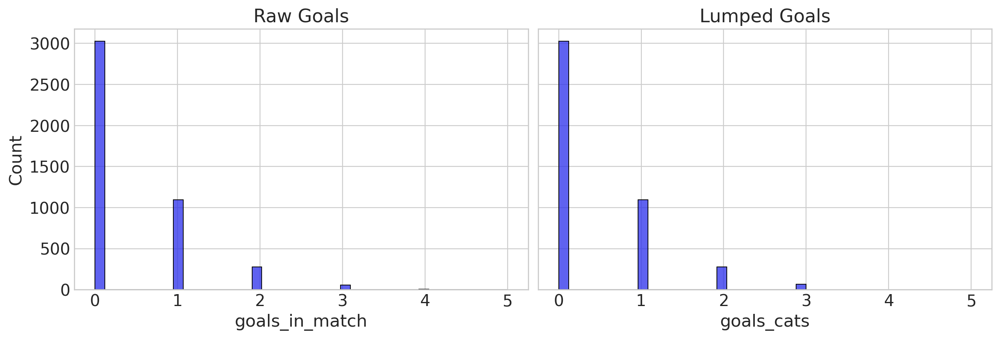

In [9]:
_, (left, right) = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(12, 4))
sns.histplot(complete_data, x="goals_in_match", ax=left)
left.set(title="Raw Goals")
sns.histplot(complete_data, x="goals_cats", ax=right)
right.set(title="Lumped Goals");

We can see that this virtually doesn't change anything, because the frequencies are so low for high counts. We can now implement the model.

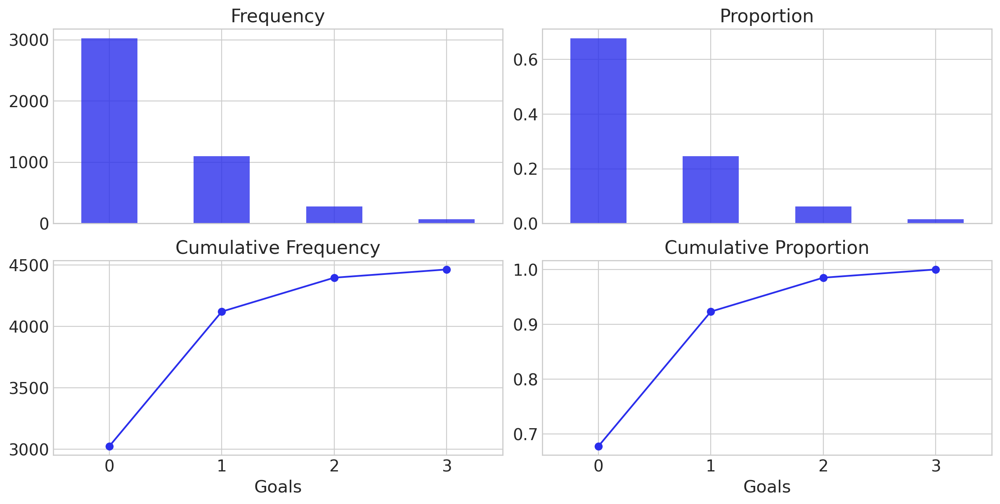

In [10]:
_, axes = plt.subplot_mosaic(
    [
        ["Frequency", "Proportion"],
        ["Cumulative Frequency", "Cumulative Proportion"],
    ],
    figsize=(12, 6),
    sharex=True,
    layout="constrained",
)

complete_data["goals_cats"].sort_values().value_counts(sort=False).plot(
    kind="bar", alpha=0.8, rot=0, ax=axes["Frequency"]
)
axes["Frequency"].set(xlabel="Goals", title="Frequency")

complete_data["goals_cats"].sort_values().value_counts(sort=False, normalize=True).plot(
    kind="bar", alpha=0.8, rot=0, ax=axes["Proportion"]
)
axes["Proportion"].set(xlabel="Goals", title="Proportion")

complete_data["goals_cats"].sort_values().value_counts(sort=False).cumsum().plot(
    marker="o", rot=0, ax=axes["Cumulative Frequency"]
)
axes["Cumulative Frequency"].set(xlabel="Goals", title="Cumulative Frequency")

complete_data["goals_cats"].sort_values().value_counts(
    sort=False, normalize=True
).cumsum().plot(marker="o", rot=0, ax=axes["Cumulative Proportion"])
axes["Cumulative Proportion"].set(xlabel="Goals", title="Cumulative Proportion");

In [11]:
complete_data["goals_cats"].sort_values().value_counts(sort=False).cumsum()

goals_cats
0    3025
1    4120
2    4396
3    4463
Name: count, dtype: int64

In [12]:
complete_data["goals_cats"].sort_values().value_counts(sort=False, normalize=True)

goals_cats
0    0.677795
1    0.245351
2    0.061842
3    0.015012
Name: proportion, dtype: float64

## Within-season & Across seasons fluctuations

> Are there non-linear effects?

### In total

In [13]:
complete_data["week_since_first_game"] = complete_data["days_since_first_game"] // 7

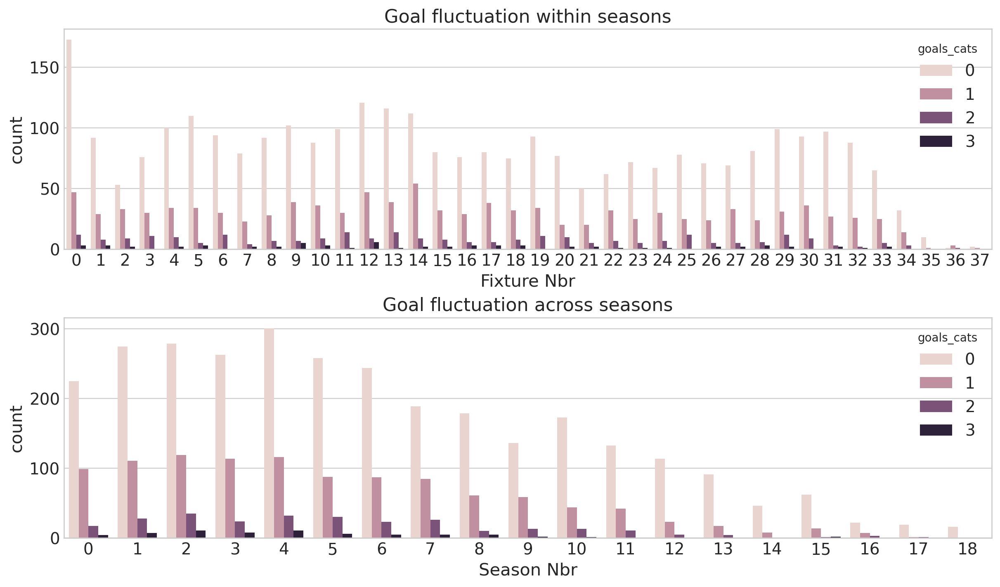

In [14]:
_, (up, down) = plt.subplots(
    2,
    1,
    figsize=(12, 7),
    layout="constrained",
)
grouped_data = (
    complete_data.groupby(["week_since_first_game", "goals_cats"])
    .size()
    .reset_index(name="count")
)
sns.barplot(
    data=grouped_data, x="week_since_first_game", y="count", hue="goals_cats", ax=up
)
up.set(title="Goal fluctuation within seasons", xlabel="Fixture Nbr")

grouped_data = (
    complete_data.groupby(["season_nbr", "goals_cats"]).size().reset_index(name="count")
)
sns.barplot(data=grouped_data, x="season_nbr", y="count", hue="goals_cats", ax=down)
down.set(title="Goal fluctuation across seasons", xlabel="Season Nbr");

### Per player

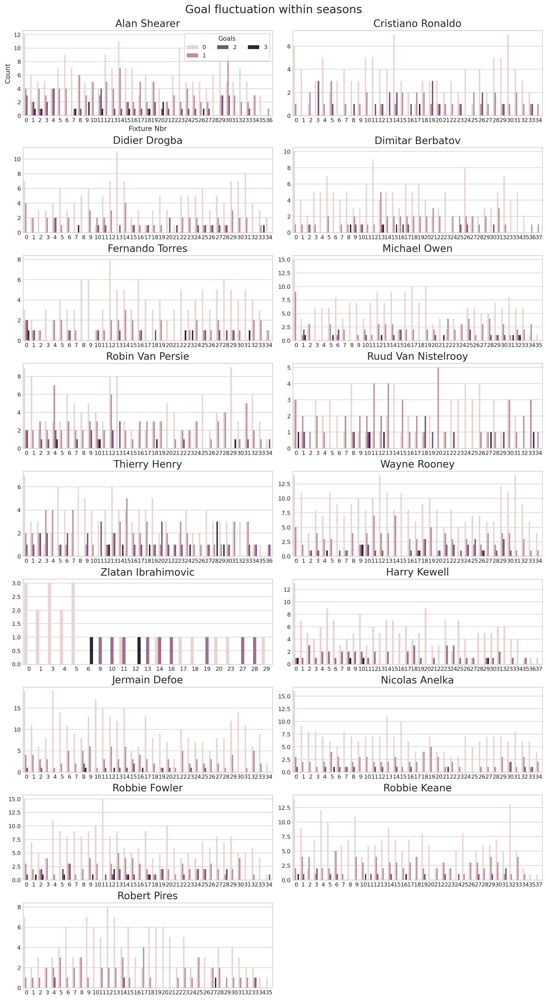

In [15]:
_, axes = plt.subplots(9, 2, figsize=(12, 22), layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    grouped_data = (
        complete_data[complete_data.name_player == player]
        .groupby(["week_since_first_game", "goals_cats"])
        .size()
        .reset_index(name="count")
    )
    sns.barplot(
        data=grouped_data, x="week_since_first_game", y="count", hue="goals_cats", ax=ax
    )
    ax.set(title=f"{player.title()}")
    ax.tick_params(axis="both", which="major", labelsize=9)
    if i > 0:
        ax.get_legend().remove()
        ax.set_xlabel("")
        ax.set_ylabel("")
    else:
        ax.set_xlabel("Fixture Nbr", fontsize=11)
        ax.set_ylabel("Count", fontsize=11)
        ax.legend(frameon=True, ncols=3, fontsize=9, title="Goals", title_fontsize=10)

plt.suptitle("Goal fluctuation within seasons", fontsize=18);

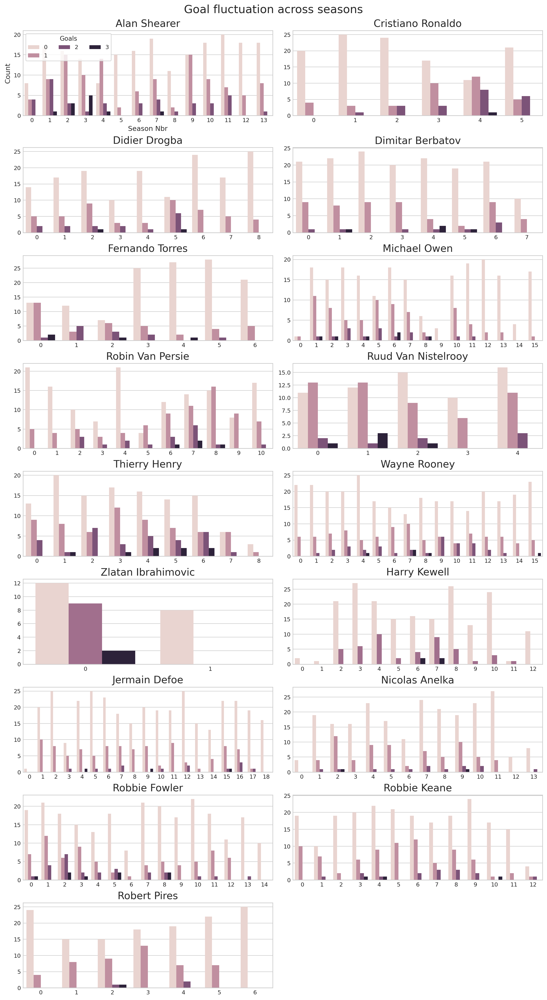

In [16]:
_, axes = plt.subplots(9, 2, figsize=(12, 22), layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    grouped_data = (
        complete_data[complete_data.name_player == player]
        .groupby(["season_nbr", "goals_cats"])
        .size()
        .reset_index(name="count")
    )
    sns.barplot(data=grouped_data, x="season_nbr", y="count", hue="goals_cats", ax=ax)
    ax.set(title=f"{player.title()}")
    ax.tick_params(axis="both", which="major", labelsize=9)
    if i > 0:
        ax.get_legend().remove()
        ax.set_xlabel("")
        ax.set_ylabel("")
    else:
        ax.set_xlabel("Season Nbr", fontsize=11)
        ax.set_ylabel("Count", fontsize=11)
        ax.legend(frameon=True, ncols=3, fontsize=9, title="Goals", title_fontsize=10)

plt.suptitle("Goal fluctuation across seasons", fontsize=18);

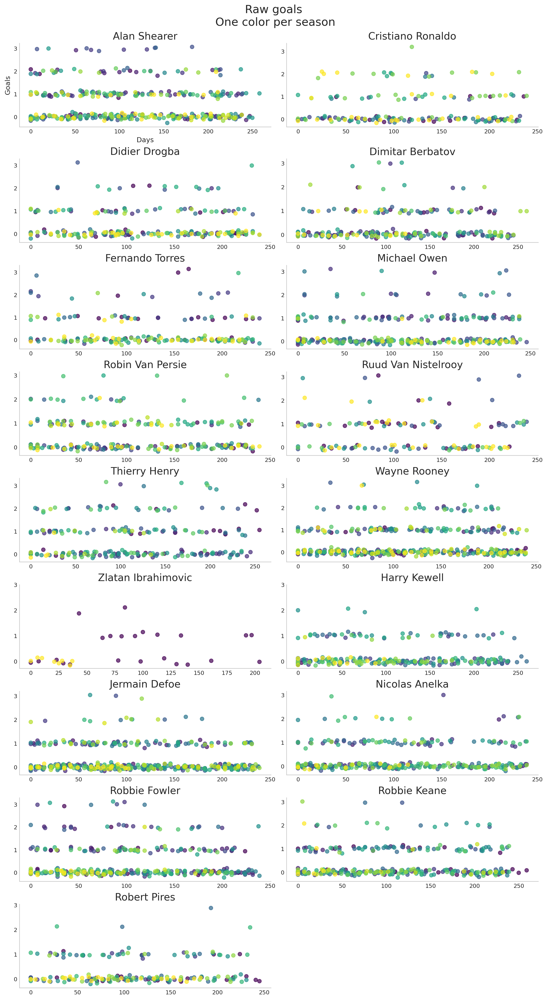

In [17]:
_, axes = plt.subplots(9, 2, figsize=(12, 22), layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):

    grouped_data = complete_data.loc[
        complete_data.name_player == player,
        ["days_since_first_game", "season_nbr", "goals_cats"],
    ].sort_values(["season_nbr", "days_since_first_game"])
    grouped_data["goals_cats"] = grouped_data["goals_cats"] + rng.normal(
        0, 0.07, len(grouped_data)
    )

    colors = plt.cm.viridis(
        grouped_data["season_nbr"] / grouped_data["season_nbr"].max()
    )
    ax.scatter(
        grouped_data["days_since_first_game"],
        grouped_data["goals_cats"],
        c=colors,
        alpha=0.7,
    )

    ax.set(title=f"{player.title()}", yticks=np.arange(4, dtype=int))
    ax.tick_params(axis="both", which="major", labelsize=9)

    if i > 0:
        ax.set(xlabel="", ylabel="")
    else:
        ax.set_xlabel("Days", fontsize=11)
        ax.set_ylabel("Goals", fontsize=11)
    sns.despine()
    ax.grid(False)

plt.suptitle("Raw goals\n One color per season", fontsize=18);

## HSGP Priors

### PC Priors on amplitude and lengthscale

In [18]:
smallest_spacing_per_season = (
    complete_data.groupby(["name_player", "season"])
    .apply(lambda group: group["days_since_first_game"].diff().dropna().min())
    .reset_index(name="min_spacing")
)
smallest_spacing_per_season.groupby("name_player")["min_spacing"].min()

/var/folders/m_/brf3tky55f3gf6dy8w7c6s0w0000gn/T/ipykernel_53943/2141993792.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda group: group["days_since_first_game"].diff().dropna().min())


name_player
alan shearer           2.0
cristiano ronaldo      2.0
didier drogba          2.0
dimitar berbatov       2.0
fernando torres        2.0
harry kewell           2.0
jermain defoe          2.0
michael owen           1.0
nicolas anelka         2.0
robbie fowler          2.0
robbie keane           1.0
robert pires           2.0
robin van persie       1.0
ruud van nistelrooy    2.0
thierry henry          2.0
wayne rooney           1.0
zlatan ibrahimovic     2.0
Name: min_spacing, dtype: float64

In [19]:
## PC prior on eta
# how "big" the GP might be as a tail probability.
# what's below means there is a 1% chance that amplitude > 3

alpha_scale, upper_scale = 0.01, 3.0
amplitude = pm.Exponential.dist(lam=-np.log(alpha_scale) / upper_scale)

## PC prior on lengthscale
# tail probability on the *smallest* lengthscale. This might be the resolution of data.
# what's below means there is a 0.1% chance that lengthscale < 2

alpha_ell, lower_ell = 0.001, 2
lam_ell = -np.log(alpha_ell) * np.sqrt(lower_ell)
alpha = 0.5
beta = 1.0 / (lam_ell**2)
ell_inv = pm.Weibull.dist(alpha=alpha, beta=beta)
lengthscale = 1 / ell_inv

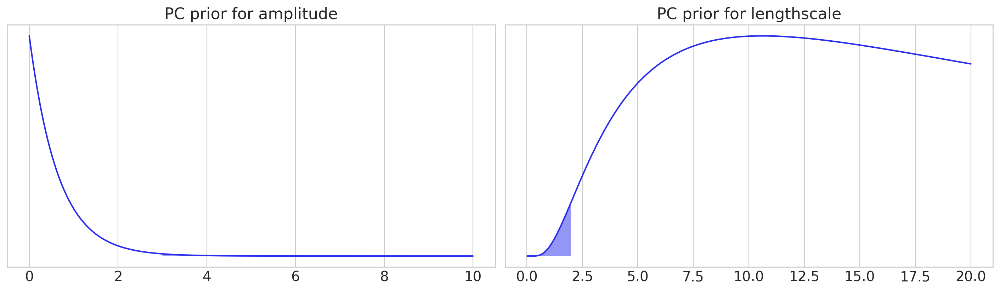

In [20]:
fig, axs = plt.subplots(1, 2, figsize=(14, 4))
axs = axs.flatten()

xx = np.linspace(0, 10, 1000)
y_eta = np.exp(pm.logp(amplitude, xx).eval())
axs[0].plot(xx, y_eta)
ix = np.argmin(np.abs(xx - upper_scale))
axs[0].fill_between(xx[ix:], np.zeros(len(xx[ix:])), y_eta[ix:], alpha=0.5)
axs[0].set_yticks([])
axs[0].set_title("PC prior for amplitude")

xx = np.linspace(0, 20, 1000)
y_ell = np.exp(pm.logp(lengthscale, xx).eval())
axs[1].plot(xx, y_ell)
ix = np.argmin(np.abs(xx - lower_ell))
axs[1].fill_between(xx[:ix], np.zeros(len(xx[:ix])), y_ell[:ix], alpha=0.5)
axs[1].set_yticks([])
axs[1].set_title("PC prior for lengthscale");

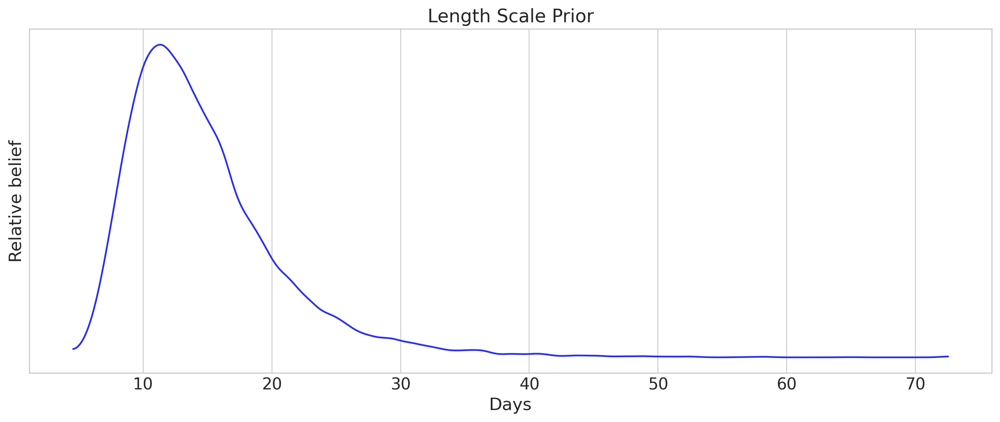

In [21]:
ls_params = pm.find_constrained_prior(
    pm.InverseGamma,
    lower=7,
    upper=30,
    init_guess={"mu": 15, "sigma": 5},
    mass=0.95,
)
ax = az.plot_dist(pm.draw(pm.InverseGamma.dist(**ls_params), draws=10_000))
ax.set(title="Length Scale Prior", xlabel="Days", ylabel="Relative belief")
ax.set_yticks([]);

### Choosing the approximation parameters

Next, we use the heuristics to choose `m` and `c`:

In [22]:
m, c = pm.gp.hsgp_approx.approx_hsgp_hyperparams(
    x_range=[0, complete_data.days_since_first_game.max()],
    lengthscale_range=[7, 60],
    cov_func="matern52",
)

print("Recommended smallest number of basis vectors (m):", m)
print("Recommended smallest scaling factor (c):", np.round(c, 1))

Recommended smallest number of basis vectors (m): 93
Recommended smallest scaling factor (c): 1.9


That actually looks a bit too low, especially `c`. We can actually check the computation by hand: we can use the `c` from above and check the implied `L`, which is the result of `set_boundary`:

In [23]:
pm.gp.hsgp_approx.set_boundary(complete_data["days_since_first_game"].to_numpy(), c)

array(246.)

What does this mean? Well, thankfully, `L` has a pretty [interpretable meaning](https://www.pymc.io/projects/examples/en/latest/gaussian_processes/HSGP-Basic.html#choosing-the-hsgp-approximation-parameters-m-l-and-c) in the HSGP decomposition. It is the boundary of the approximation, so we need to chose `L` such that the domain `[-L, L]` contains all points, not only for training, but also for out-of-sample predictions (which is not a concern here).

Now, the maximum of the observed days is:

In [24]:
complete_data.days_since_first_game.max()

260

So we want $L > 260$ in this case, which means we need to increase `c` until we're satisfied:

In [25]:
pm.gp.hsgp_approx.set_boundary(complete_data["days_since_first_game"].to_numpy(), 2.5)

array(325.)

Bingo! This is actually a bit too much, but that's fine, as increasing `c` doesn't increase the computational cost of HSGP. It does require increasing `m` to compensate for the loss of fidelity at smaller lengthscales. So let's err on the side of safety and choose:

In [26]:
m, c = 120, 2.5

## PyMC Model

In [27]:
player_idx = pd.Categorical(
    complete_data["name_player"], categories=players_ordered
).codes
day_idx, days = complete_data["days_since_first_game"].factorize(sort=True)

coords = {
    "elite": players.difference(RLPs),
    "rlp": RLPs,
    "player": players_ordered,
    "factor": factors,
    "obs_id": complete_data.index,
    "diversity_elite_param": ["baseline_elite", "maturity_effect_elite"],
    "diversity_rlp_param": ["baseline_rlp", "maturity_effect_rlp"],
    "event": complete_data["goals_cats"].factorize(sort=True)[1],
    "day": days,
}
n_elite = len(coords["elite"])
n_rlp = len(coords["rlp"])
K = len(coords["event"])

To build this model to allow different lengthscales per GP, we need to rewrite the power spectral density.  The one attached to the PyMC covariance classes, i.e. `pm.gp.cov.Matern52.power_spectral_density`, is vectorized over the _input dimension_, but we need one vectorized across _GPs_.

Fortunately, this one at least isn't too hard to adapt:

### Adapting the power spectral density

In [28]:
def matern52_psd(omega, ls):
    """
    Calculate the power spectral density for the Matern52 covariance kernel.

    Inputs:
      - omega: The frequencies where the power spectral density is evaluated
      - ls: The lengthscales. Can be a scalar or a vector.
    """
    num = 2.0 * np.sqrt(np.pi) * pt.gamma(3.0) * pt.power(5.0, 5.0 / 2.0)
    den = 0.75 * pt.sqrt(np.pi)
    return (
        (num / den)
        * ls
        * pt.power(5.0 + pt.outer(pt.square(omega), pt.square(ls)), -3.0)
    )

#### TODO: ADD EXPLANATORY TEXT AND SIMPLIFY MODEL CODE WITH SUB-FUNCTIONS

In [77]:
with pm.Model(coords=coords) as SFM_rlp:

    # Data containers
    seasons = pm.Data("seasons", complete_data["season_nbr"].to_numpy(), dims="obs_id")
    day_id = pm.Data("day_id", day_idx, dims="obs_id")
    player_id = pm.Data("player_id", player_idx, dims="obs_id")
    factor_data = pm.Data(
        "factor_data", factors_sdz.to_numpy(), dims=("obs_id", "factor")
    )
    goals_obs = pm.Data(
        "goals_obs", complete_data["goals_cats"].to_numpy(), dims="obs_id"
    )

    # player skills
    ## elite players, partially-pooled
    diversity = pm.Gamma("diversity_elite", 2, 2, dims="diversity_elite_param")

    mu = pm.Normal("baseline_elite_mean")
    baseline_elite = mu + diversity[0] * pm.ZeroSumNormal(
        "baseline_elite_offset", dims="elite"
    )

    mu = pm.Normal("maturity_effect_elite_mean", sigma=0.5)
    maturity_effect_elite = mu + diversity[1] * pm.ZeroSumNormal(
        "maturity_effect_elite_offset", dims="elite"
    )

    ### priors on GP hyperparameters
    ## TODO: try a 2D GP for interaction on season-nbr and day-of-season
    ## TODO: try hierarchical GP
    ## handle 0-centering correctly
    x_center = (np.max(days) + np.min(days)) / 2
    X_gp = pm.Data("days", days.to_numpy(), dims="day")[:, None]
    Xs = X_gp - x_center

    amplitude = pm.Gamma("amplitude_elite", 2, 2)

    mu = pm.Normal("log_ell_mu_elite")
    offset = pm.ZeroSumNormal("log_ell_offset_elite", dims="elite")
    sd = pm.Gamma("log_ell_sd_elite", 2, 2)
    log_ell = mu + sd * offset
    ell = pm.Deterministic("ell_elite", pt.softplus(log_ell), dims="elite")

    L = pm.gp.hsgp_approx.set_boundary(Xs, c)
    eigvals = pm.gp.hsgp_approx.calc_eigenvalues(L, [m])
    phi = pm.gp.hsgp_approx.calc_eigenvectors(Xs, L, eigvals, [m])
    omega = pt.sqrt(eigvals)
    psd = matern52_psd(omega, ell)

    ### non-centered GP approximation:
    basis_coeffs = pm.Normal("basis_coeffs_elite", shape=(int(np.prod(m)), n_elite))
    f_season_effect_elite = pm.Deterministic(
        "f_season_effect_elite",
        phi @ (basis_coeffs * pt.sqrt(psd) * amplitude),
        dims=("day", "elite"),
    )

    ## RL players, partially-pooled
    diversity = pm.Gamma("diversity_rlp", 2, 2, dims="diversity_rlp_param")

    mu = pm.Normal("baseline_rlp_mean")
    baseline_rlp = mu + diversity[0] * pm.ZeroSumNormal(
        "baseline_rlp_offset", dims="rlp"
    )

    mu = pm.Normal("maturity_effect_rlp_mean", sigma=0.5)
    maturity_effect_rlp = mu + diversity[1] * pm.ZeroSumNormal(
        "maturity_effect_rlp_offset", dims="rlp"
    )

    amplitude = pm.Gamma("amplitude_rlp", 2, 2)

    mu = pm.Normal("log_ell_mu_rlp")
    offset = pm.ZeroSumNormal("log_ell_offset_rlp", dims="rlp")
    sd = pm.Gamma("log_ell_sd_rlp", 2, 2)
    log_ell = mu + sd * offset
    ell = pm.Deterministic("ell_rlp", pt.softplus(log_ell), dims="rlp")

    psd = matern52_psd(omega, ell)

    ### non-centered GP approximation:
    basis_coeffs = pm.Normal("basis_coeffs_rlp", shape=(int(np.prod(m)), n_rlp))
    f_season_effect_rlp = pm.Deterministic(
        "f_season_effect_rlp",
        phi @ (basis_coeffs * pt.sqrt(psd) * amplitude),
        dims=("day", "rlp"),
    )

    ## concatenate levels
    # dims="player"
    baseline = pt.concatenate([baseline_elite, baseline_rlp])
    maturity_effect = pt.concatenate([maturity_effect_elite, maturity_effect_rlp])
    f_season_effect = pt.concatenate(
        [f_season_effect_elite, f_season_effect_rlp],
        axis=-1,
    )  # dims=("day", "player"),

    # regression for player skills
    alpha = pm.Deterministic(
        "alpha",
        baseline[player_id]
        + maturity_effect[player_id] * seasons
        + f_season_effect[day_id, player_id],
        dims="obs_id",
    )

    # team factors
    beta = pm.Normal("beta", mu=0, sigma=0.5, dims="factor")

    # regression
    eta = pm.Deterministic("eta", alpha + pm.math.dot(factor_data, beta), dims="obs_id")

    # prior on cutpoints
    diversity = pm.Gamma("cutpoints_diversity", 2, 2)
    cutpoints = pm.Normal(
        "cutpoints",
        mu=[1, 4, 7],
        sigma=diversity,
        transform=pm.distributions.transforms.ordered,
    )

    # likelihood
    pm.OrderedLogistic(
        "goals_scored",
        cutpoints=cutpoints,
        eta=eta,
        observed=goals_obs,
        dims="obs_id",
    )

    idata = pm.sample_prior_predictive(random_seed=rng)

Sampling: [amplitude_elite, amplitude_rlp, baseline_elite_mean, baseline_elite_offset, baseline_rlp_mean, baseline_rlp_offset, basis_coeffs_elite, basis_coeffs_rlp, beta, cutpoints, cutpoints_diversity, diversity_elite, diversity_rlp, goals_scored, log_ell_mu_elite, log_ell_mu_rlp, log_ell_offset_elite, log_ell_offset_rlp, log_ell_sd_elite, log_ell_sd_rlp, maturity_effect_elite_mean, maturity_effect_elite_offset, maturity_effect_rlp_mean, maturity_effect_rlp_offset]


In [78]:
idata.prior = idata.prior.rename({"goals_scored_probs_dim_1": "event"})

mindex_coords = xr.Coordinates.from_pandas_multiindex(
    complete_data.set_index(["name_player", "season", "days_since_first_game"]).index,
    "obs_id",
)

idata.prior = idata.prior.assign_coords(mindex_coords)
idata.prior_predictive = idata.prior_predictive.assign_coords(mindex_coords)
idata.observed_data = idata.observed_data.assign_coords(mindex_coords)

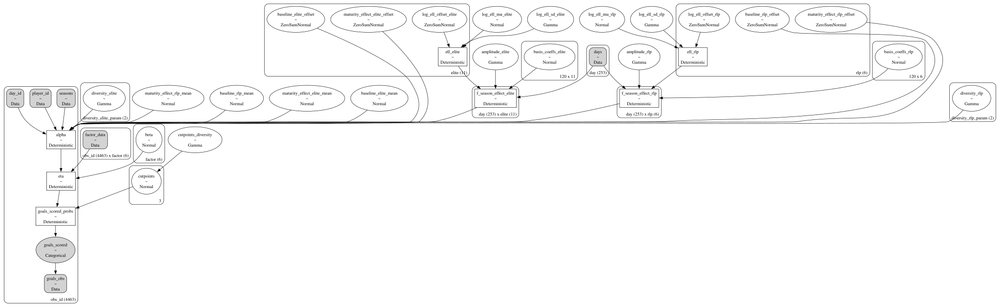

In [79]:
pm.model_to_graphviz(SFM_rlp)

## Prior checks

### Prior cutpoints

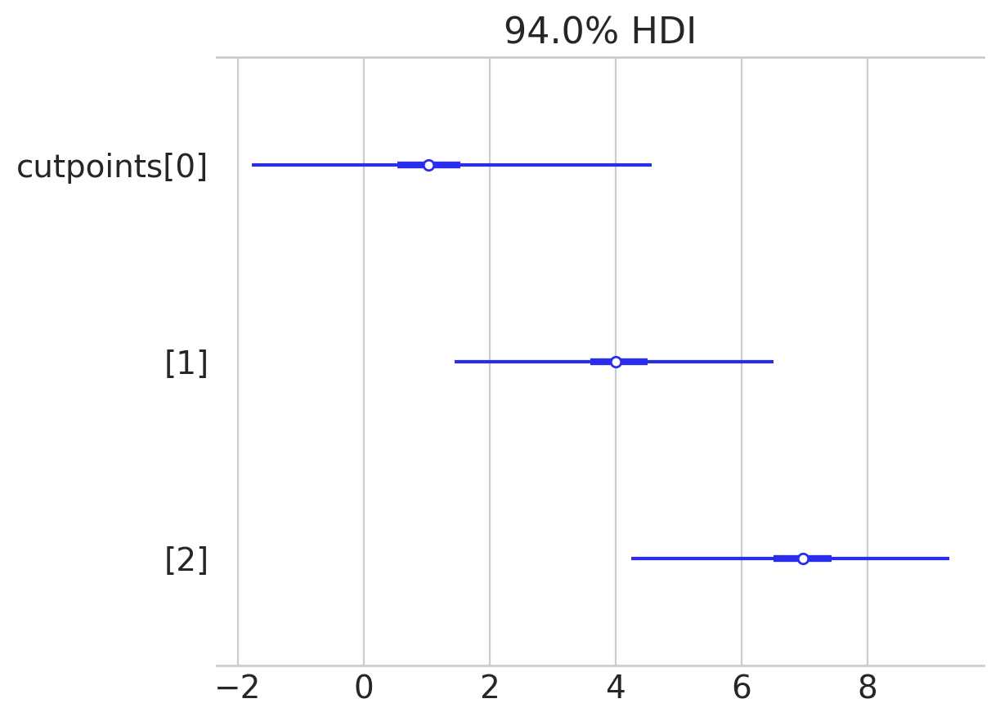

In [36]:
az.plot_forest(idata.prior["cutpoints"]);

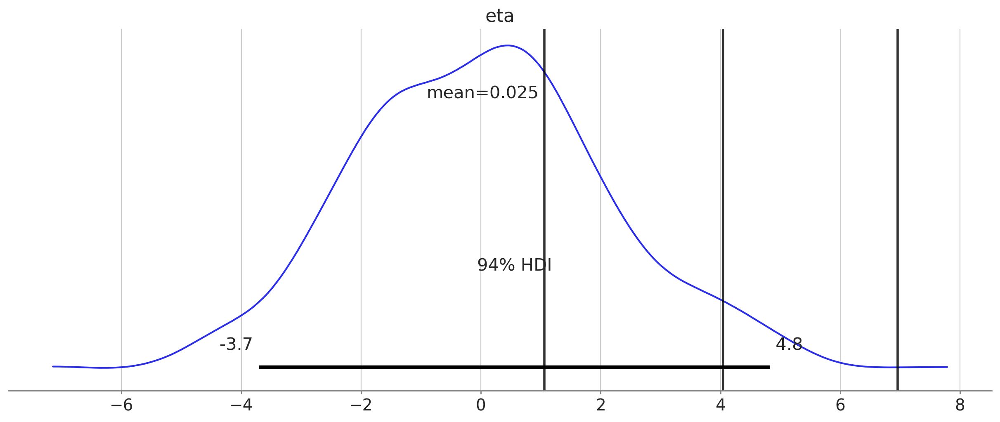

In [37]:
ax = az.plot_posterior(idata.prior["eta"].isel(obs_id=0))
for i in range(K - 1):
    ax.axvline(
        idata.prior["cutpoints"].isel(cutpoints_dim_0=i).mean().data,
        color="k",
        lw=2,
        alpha=0.8,
    )

In [38]:
implied_probs = az.extract(idata.prior, var_names="goals_scored_probs")

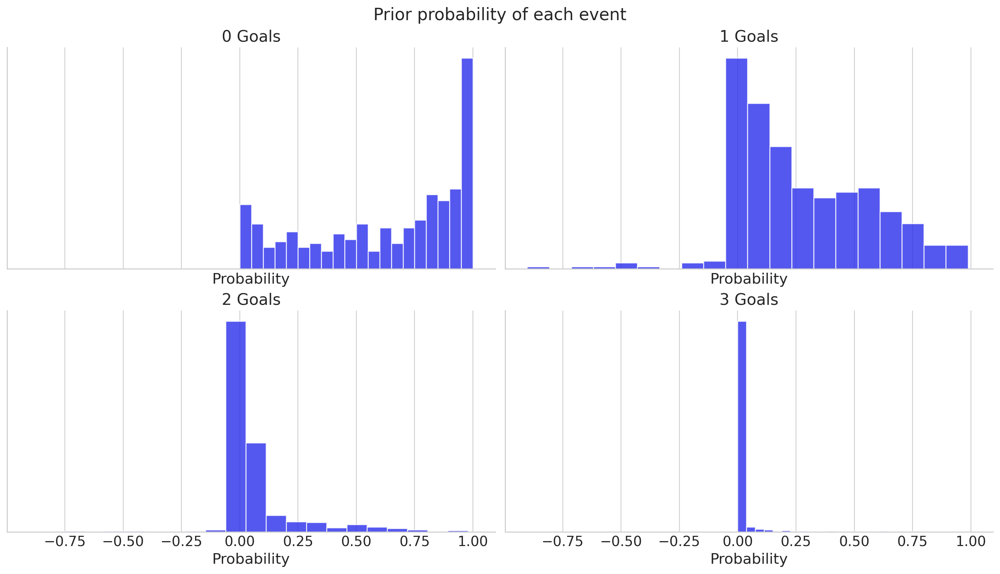

In [39]:
_, axes = plt.subplots(2, 2, figsize=(14, 8), sharex=True, layout="constrained")
axes = axes.flatten()

for i, ax in enumerate(axes):
    ax.hist(implied_probs.isel(obs_id=0, event=i), ec="white", bins=20, alpha=0.8)
    ax.set(xlabel="Probability", yticklabels="", title=f"{i} Goals")
    ax.set_yticks([])
    sns.despine()
plt.suptitle("Prior probability of each event", fontsize=17);

In [40]:
implied_class = az.extract(idata.prior_predictive, var_names="goals_scored")

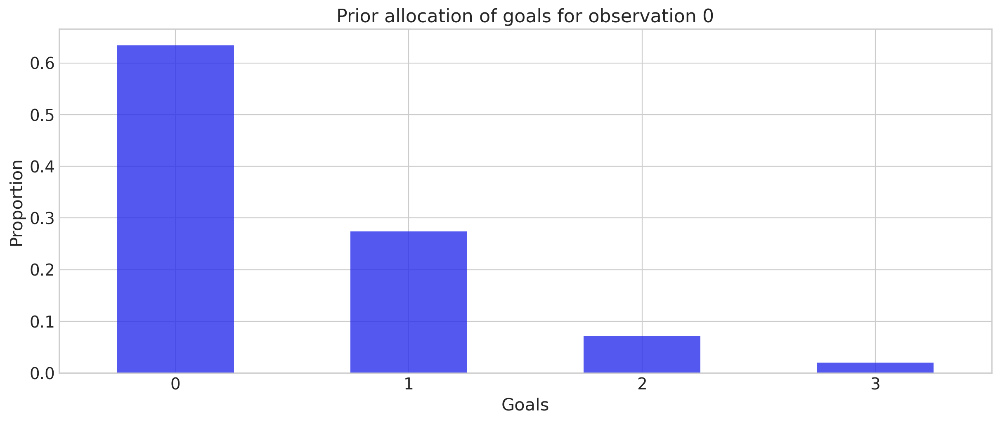

In [41]:
ax = (
    implied_class.isel(obs_id=0)
    .to_pandas()
    .reset_index(drop=True)
    .value_counts(normalize=True)
    .sort_index()
    .plot(kind="bar", rot=0, alpha=0.8)
)
ax.set(
    xlabel="Goals",
    ylabel="Proportion",
    title="Prior allocation of goals for observation 0",
);

### Prior predictive checks

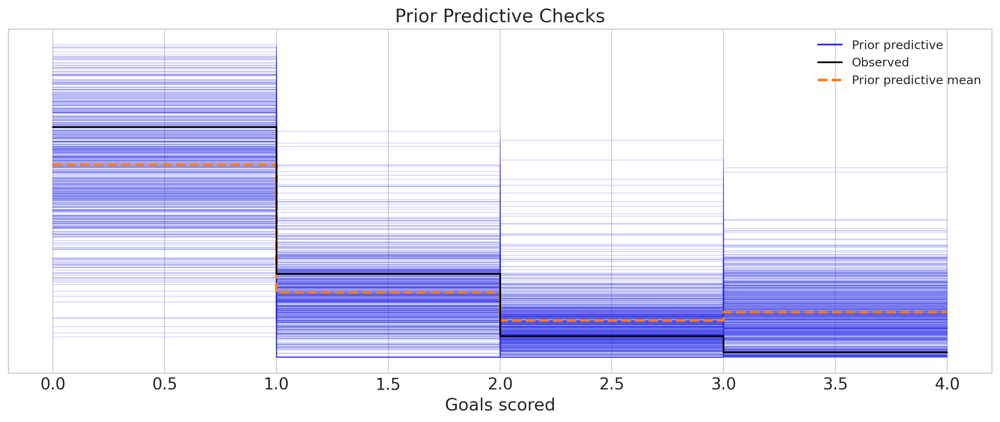

In [42]:
ax = az.plot_ppc(idata, group="prior", observed=True)
ax.set(xlabel="Goals scored", title="Prior Predictive Checks");

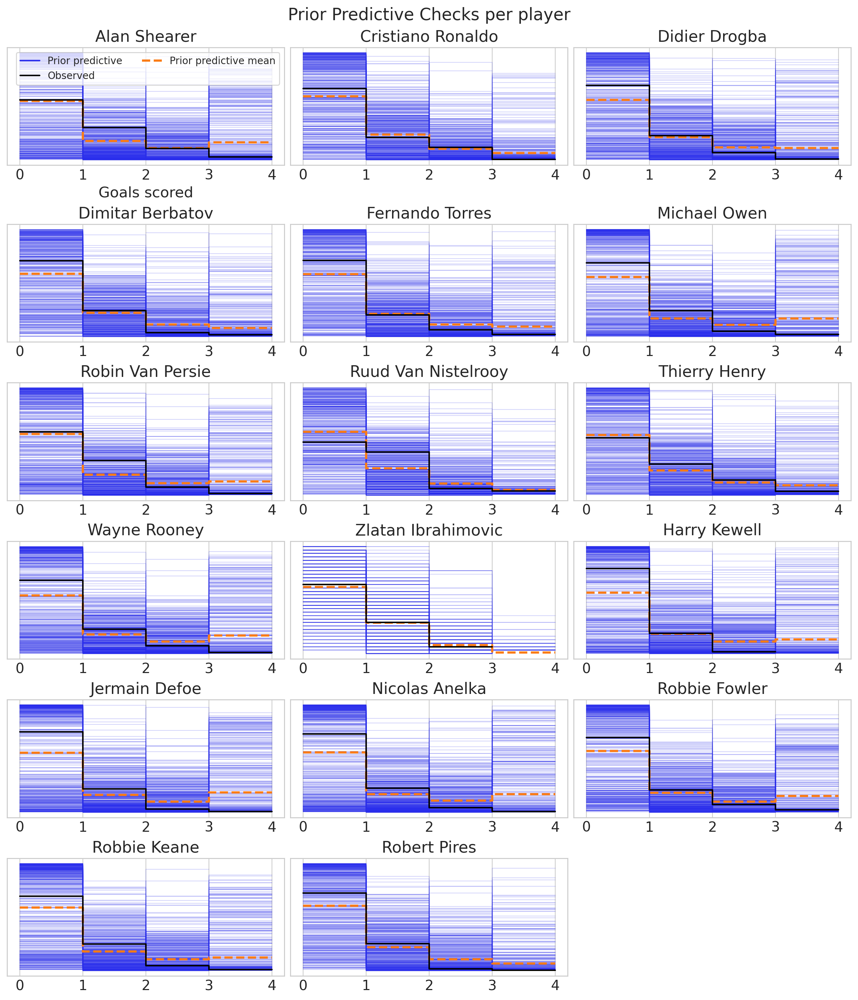

In [43]:
_, axes = plt.subplots(6, 3, figsize=(12, 14))
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    idata_plot = idata.copy()
    idata_plot.observed_data = idata.observed_data.sel(name_player=player)
    idata_plot.prior_predictive = idata.prior_predictive.sel(name_player=player)

    az.plot_ppc(idata_plot, group="prior", observed=True, ax=ax)
    ax.set(xlabel="Goals scored", yticklabels=[], title=player.title())
    if i > 0:
        ax.get_legend().remove()
        ax.set(xlabel="")
    else:
        ax.legend(ncols=2, fontsize=10, frameon=True)

plt.suptitle("Prior Predictive Checks per player", fontsize=17);

### TO UPDATE: Prior PAR

In [30]:
with pm.Model(coords=coords) as synthetic_player:
    player_id_new = pt.random.choice(len(RLPs))

    alpha_new = (
        baseline_rlp[player_id_new]
        + maturity_effect_rlp[player_id_new] * seasons
        + within_season_effect_rlp[player_id_new] * days
    )

    eta_new = alpha_new + pm.math.dot(factor_data, beta)

    pm.OrderedLogistic(
        "goals_scored_new",
        cutpoints=cutpoints,
        eta=eta_new,
        dims="obs_id",
    )

    rlp_prior_preds = pm.sample_prior_predictive(
        var_names=["goals_scored_new"],
        random_seed=rng,
    )

Sampling: [goals_scored_new]


In [31]:
rlp_prior_preds.prior = rlp_prior_preds.prior.assign_coords(mindex_coords)

elite_players_prior = idata.prior_predictive["goals_scored"]
rl_players_prior = rlp_prior_preds.prior["goals_scored_new"]

par = (elite_players_prior - rl_players_prior).rename("Prior PAR").reset_index("obs_id")
elite_par_prior = par.where(par["name_player"].isin(coords["elite"]), drop=True)
rlp_par_prior = par.where(par["name_player"].isin(coords["rlp"]), drop=True)

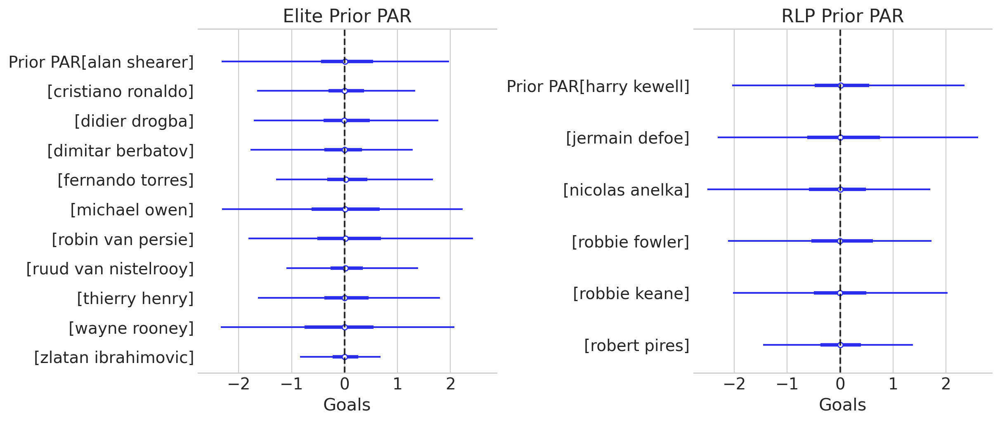

In [32]:
_, (left, right) = plt.subplots(1, 2, sharex=True)

az.plot_forest(
    elite_par_prior.groupby("name_player").mean("obs_id"),
    combined=True,
    ax=left,
)
left.axvline(c="k", ls="--", alpha=0.8)
left.set(title="Elite Prior PAR", xlabel="Goals")

az.plot_forest(
    rlp_par_prior.groupby("name_player").mean("obs_id"),
    combined=True,
    ax=right,
)
right.axvline(c="k", ls="--", alpha=0.8)
right.set(title="RLP Prior PAR", xlabel="Goals");

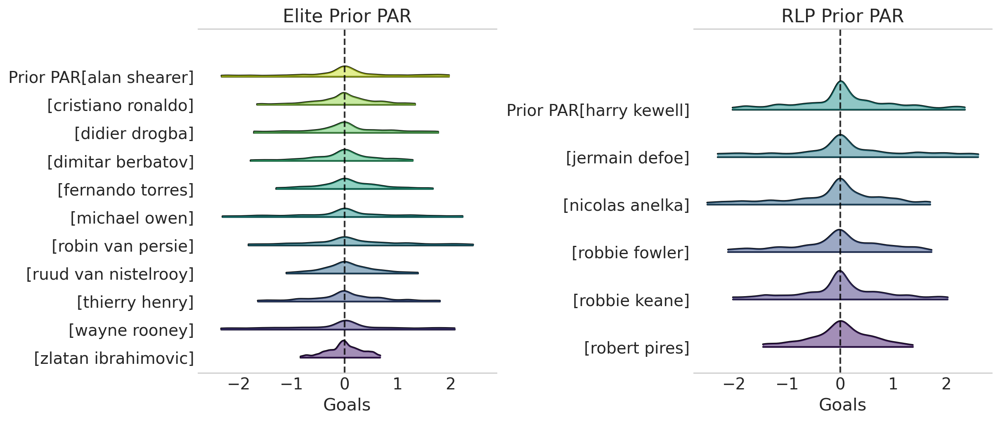

In [33]:
_, (left, right) = plt.subplots(1, 2, sharex=True)

az.plot_forest(
    elite_par_prior.groupby("name_player").mean("obs_id"),
    combined=True,
    kind="ridgeplot",
    ridgeplot_overlap=1.5,
    ridgeplot_alpha=0.5,
    ax=left,
)

colors = sns.color_palette("viridis", n_colors=len(coords["elite"]))
# adjust colors manually
for patch, color in zip(left.collections, colors):
    patch.set_color(color)

left.axvline(c="k", ls="--", alpha=0.8)
left.set(title="Elite Prior PAR", xlabel="Goals")

az.plot_forest(
    rlp_par_prior.groupby("name_player").mean("obs_id"),
    combined=True,
    kind="ridgeplot",
    ridgeplot_overlap=1.5,
    ridgeplot_alpha=0.5,
    ax=right,
)

for patch, color in zip(right.collections, colors):
    patch.set_color(color)

right.axvline(c="k", ls="--", alpha=0.8)
right.set(title="RLP Prior PAR", xlabel="Goals");

In [34]:
axes = az.plot_posterior(
    par.groupby("name_player").mean("obs_id"),
    kind="hist",
    grid=(6, 3),
    textsize=32,
    ref_val=0,
    ref_val_color="k",
    round_to=2,
)

# customize bar colors
colors = sns.color_palette("viridis", n_colors=len(players_ordered))
for ax, color in zip(axes.flatten(), colors[::-1]):
    for bar in ax.patches:
        bar.set_facecolor(color)

## Sampling and convergence checks

In [80]:
with SFM_rlp:
    idata.extend(pm.sample(nuts_sampler="numpyro", random_seed=rng))
    idata.extend(pm.sample_posterior_predictive(idata, random_seed=rng))

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

Sampling: [goals_scored]


Output()

In [81]:
idata.sample_stats.diverging.sum().data

array(0)

In [82]:
az.ess(idata).min().to_pandas().sort_values().round()

diversity_elite                 1174.0
diversity_rlp                   1514.0
maturity_effect_elite_offset    1642.0
amplitude_elite                 1693.0
amplitude_rlp                   1772.0
alpha                           2027.0
eta                             2032.0
maturity_effect_elite_mean      2113.0
baseline_rlp_mean               2156.0
cutpoints                       2162.0
baseline_elite_mean             2163.0
goals_scored_probs              2310.0
f_season_effect_elite           2527.0
f_season_effect_rlp             2665.0
log_ell_sd_elite                2917.0
baseline_elite_offset           3354.0
log_ell_sd_rlp                  3514.0
ell_elite                       3568.0
maturity_effect_rlp_offset      3641.0
beta                            3959.0
cutpoints_diversity             4154.0
log_ell_offset_elite            4181.0
ell_rlp                         4214.0
baseline_rlp_offset             4343.0
log_ell_mu_elite                4893.0
log_ell_offset_rlp       

In [83]:
az.summary(
    idata,
    var_names=["cutpoints"],
    filter_vars="regex",
    round_to=2,
)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
cutpoints[0],1.33,0.57,0.20,2.33,0.01,0.01,2162.13,1923.99,1.0
cutpoints[1],3.17,0.57,2.03,4.17,0.01,0.01,2162.45,1905.78,1.0
cutpoints[2],4.93,0.59,3.78,5.96,0.01,0.01,2233.30,1823.27,1.0
cutpoints_diversity,1.41,0.55,0.54,2.43,0.01,0.01,4153.62,3057.26,1.0


/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.11/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (22), generating only 20 plots
  warnings.warn(


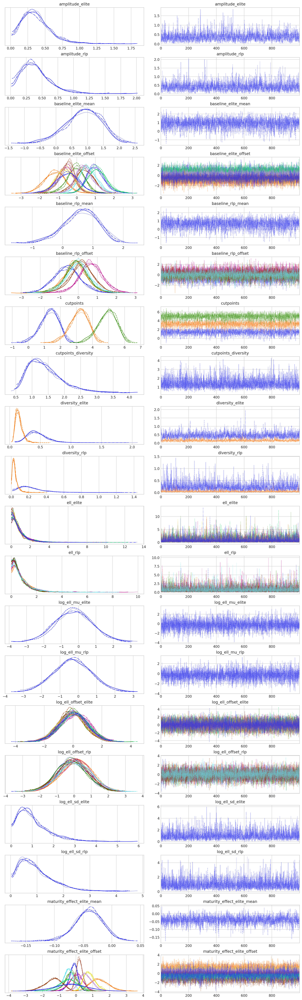

In [84]:
az.plot_trace(
    idata,
    var_names=["~alpha", "~goals_scored_probs", "~eta", "~f_season_", "~basis_coeffs"],
    filter_vars="regex",
);

In [85]:
az.plot_dist_comparison(
    idata,
    var_names=[
        "beta",
        "diversity_elite",
        "diversity_rlp",
        "baseline_rlp_mean",
        "maturity_effect_rlp_mean",
    ],
);

In [86]:
az.plot_dist_comparison(
    idata,
    var_names=[
        "cutpoints",
        "cutpoints_diversity",
        "amplitude_elite",
        "amplitude_rlp",
        "log_ell_mu_elite",
        "log_ell_mu_rlp",
        "log_ell_sd_elite",
        "log_ell_sd_rlp",
        "baseline_elite_mean",
        "maturity_effect_elite_mean",
    ],
);

## Posterior parameters

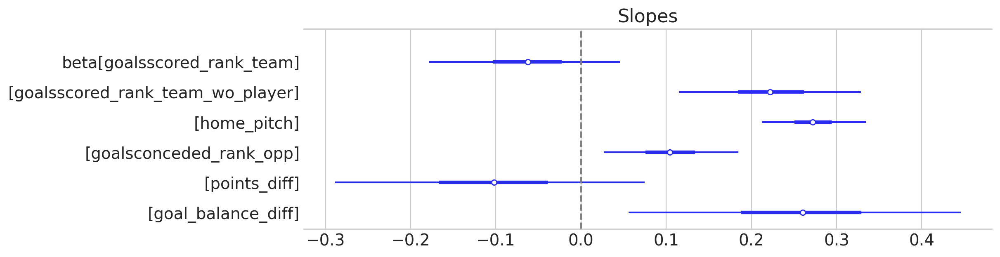

In [51]:
ax = az.plot_forest(idata, var_names="beta", combined=True, figsize=(12, 3))
ax[0].axvline(c="grey", ls="--")
ax[0].set(title="Slopes");

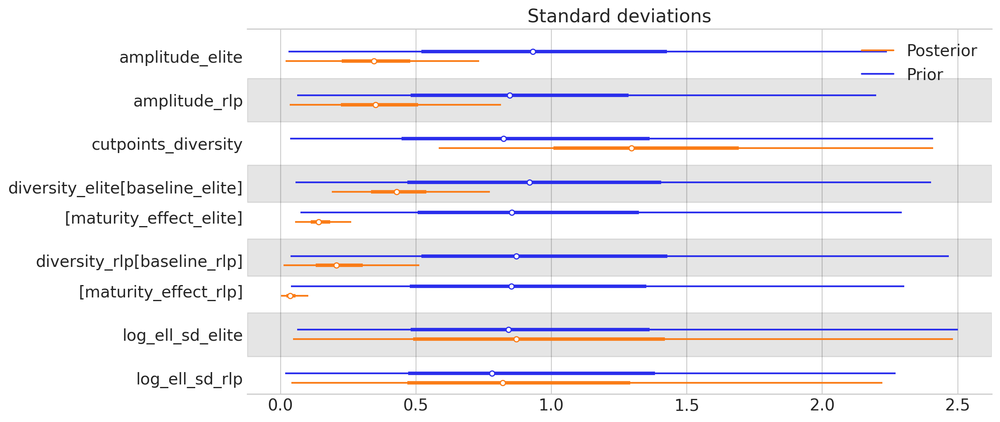

In [52]:
ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names=["diversity", "amplitude", "sd_"],
    combined=True,
    filter_vars="regex",
    figsize=(12, 5),
)
ax[0].set(title="Standard deviations");

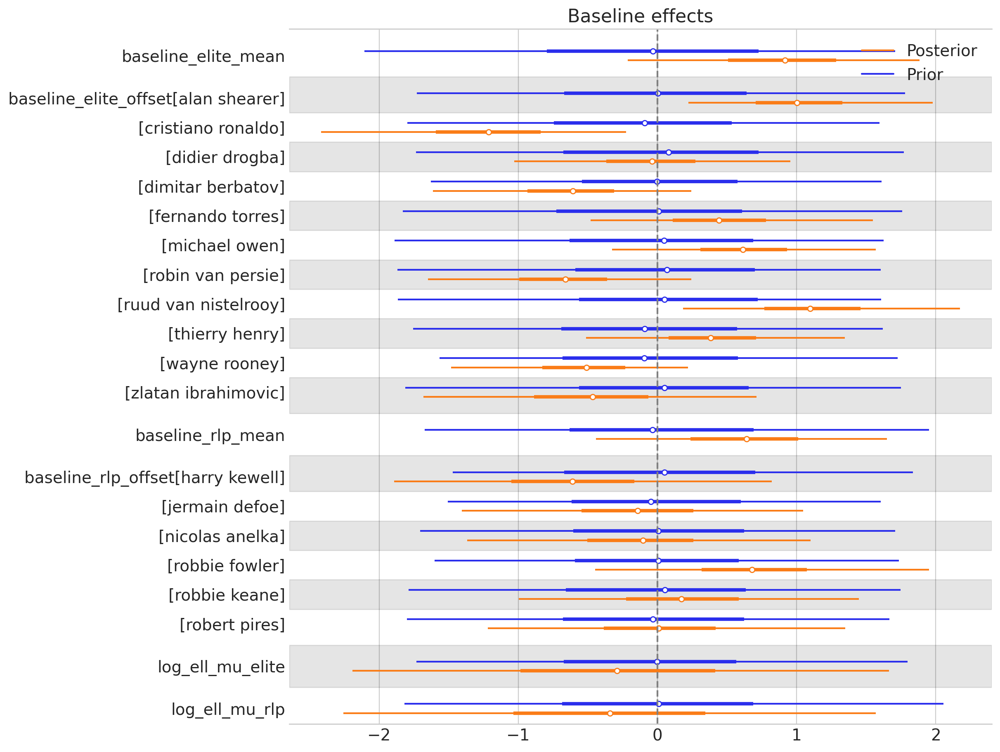

In [53]:
ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names=["baseline_", "mu_"],
    filter_vars="regex",
    combined=True,
    figsize=(12, 9),
)
ax[0].axvline(c="grey", ls="--")
ax[0].set(title="Baseline effects");

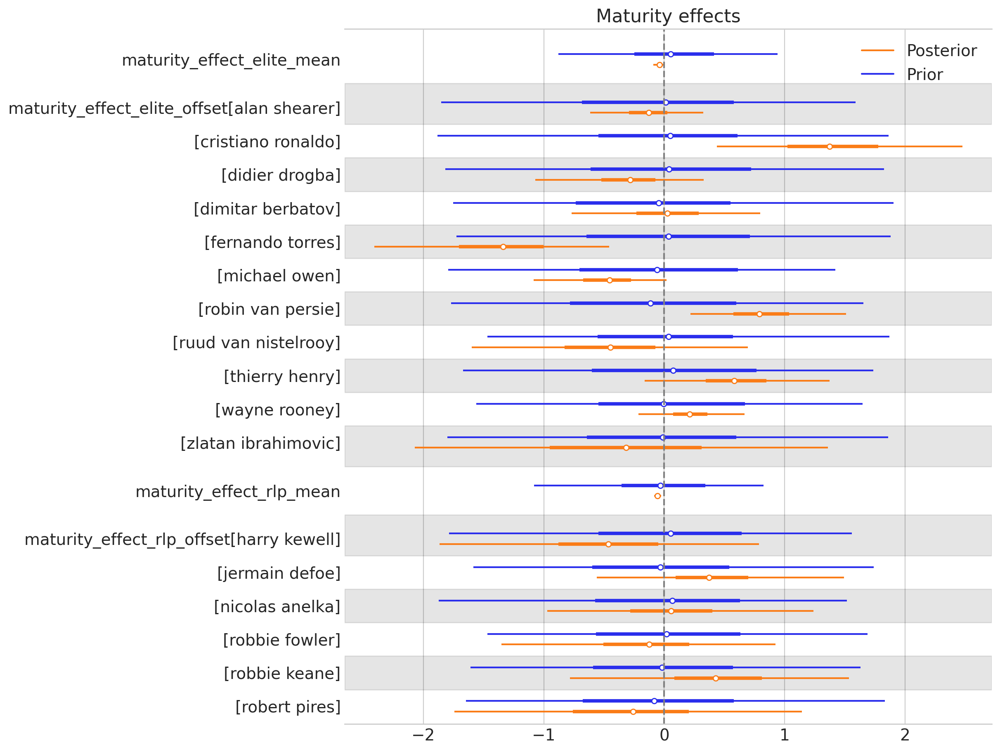

In [54]:
ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="maturity_effect",
    filter_vars="regex",
    combined=True,
    figsize=(12, 9),
)
ax[0].axvline(c="grey", ls="--")
ax[0].set(title="Maturity effects");

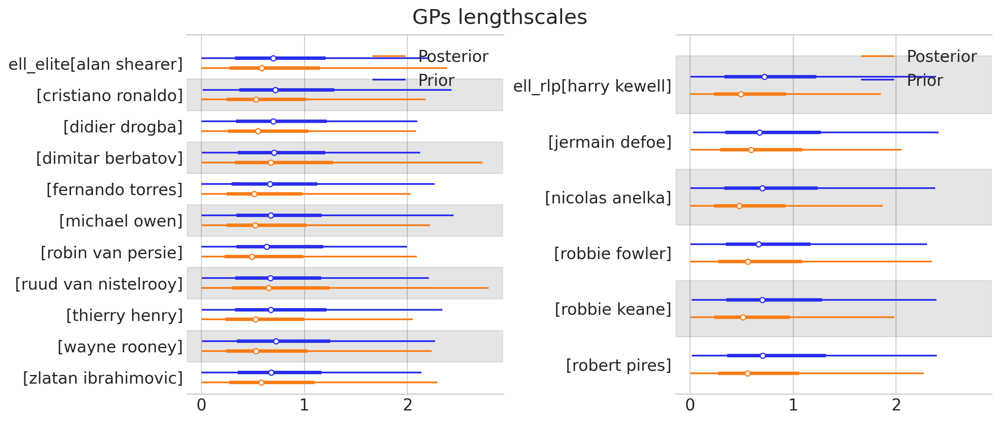

In [55]:
_, (left, right) = plt.subplots(1, 2, figsize=(12, 5), sharex=True)

ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="ell_elite",
    combined=True,
    ax=left,
)
left.set(title="")

ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="ell_rlp",
    combined=True,
    ax=right,
)
right.set(title="")

plt.suptitle("GPs lengthscales", fontsize=18);

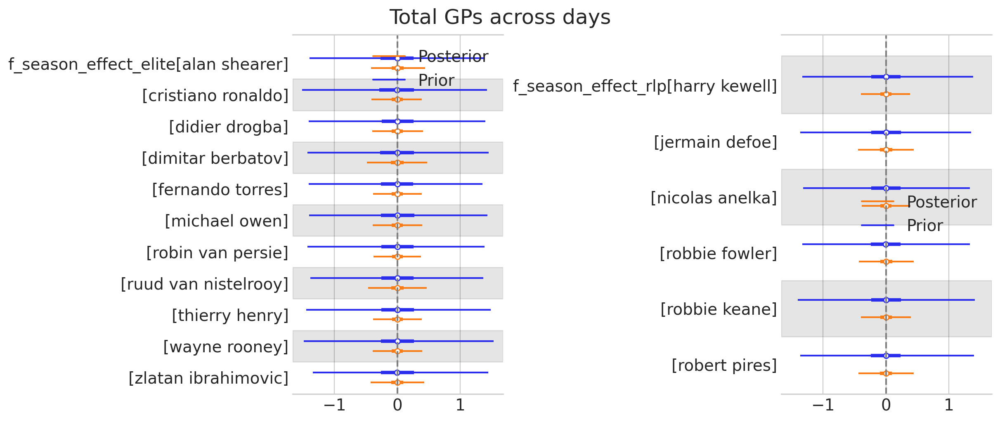

In [56]:
_, (left, right) = plt.subplots(1, 2, figsize=(12, 5), sharex=True)

ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="f_season_effect_elite",
    combined=True,
    combine_dims=set(("chain", "draw", "day")),
    ax=left,
)
left.axvline(c="grey", ls="--")
left.set(title="")

ax = az.plot_forest(
    [idata.prior, idata.posterior],
    model_names=["Prior", "Posterior"],
    var_names="f_season_effect_rlp",
    combined=True,
    combine_dims=set(("chain", "draw", "day")),
    ax=right,
)
right.axvline(c="grey", ls="--")
right.set(title="")

plt.suptitle("Total GPs across days", fontsize=18);

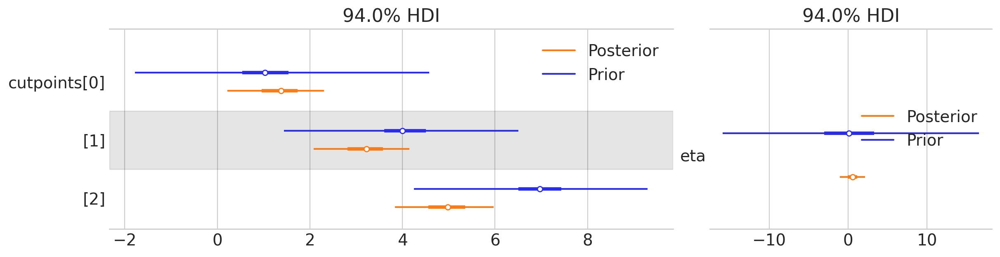

In [57]:
_, axes = plt.subplot_mosaic(
    """
    AAB
    """,
    figsize=(12, 3),
    layout="constrained",
)

az.plot_forest(
    [idata.prior["cutpoints"], idata.posterior["cutpoints"]],
    combined=True,
    model_names=["Prior", "Posterior"],
    ax=axes["A"],
)

az.plot_forest(
    [idata.prior["eta"], idata.posterior["eta"]],
    combine_dims={"chain", "draw", "obs_id"},
    combined=True,
    model_names=["Prior", "Posterior"],
    ax=axes["B"],
);

## Posterior predictive checks

In [87]:
idata.posterior = idata.posterior.rename({"goals_scored_probs_dim_1": "event"})
idata.posterior = idata.posterior.assign_coords(mindex_coords)
idata.posterior_predictive = idata.posterior_predictive.assign_coords(mindex_coords)

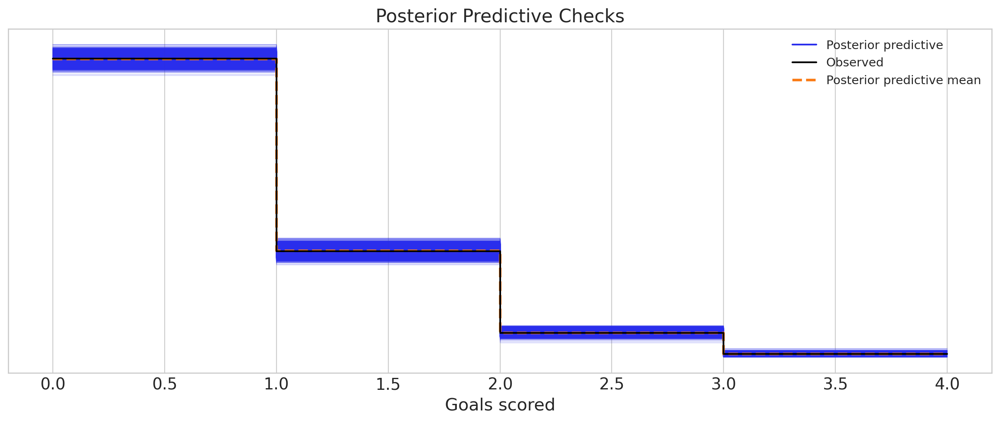

In [59]:
ax = az.plot_ppc(idata)
ax.set(xlabel="Goals scored", title="Posterior Predictive Checks");

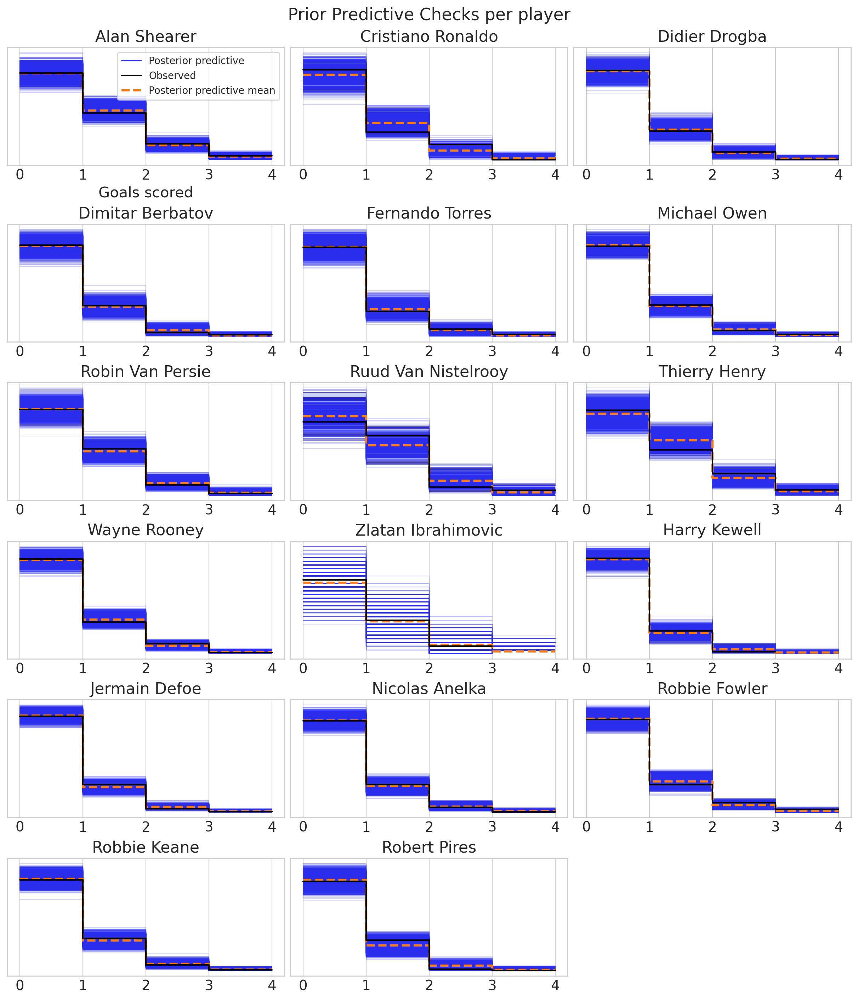

In [60]:
_, axes = plt.subplots(6, 3, figsize=(12, 14))
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    idata_plot = idata.copy()
    idata_plot.observed_data = idata.observed_data.sel(name_player=player)
    idata_plot.posterior_predictive = idata.posterior_predictive.sel(name_player=player)

    az.plot_ppc(idata_plot, ax=ax)
    ax.set(xlabel="Goals scored", yticklabels=[], title=player.title())
    if i > 0:
        ax.get_legend().remove()
        ax.set(xlabel="")
    else:
        ax.legend(fontsize=10, frameon=True)

plt.suptitle("Prior Predictive Checks per player", fontsize=17);

## Categorical probabilities

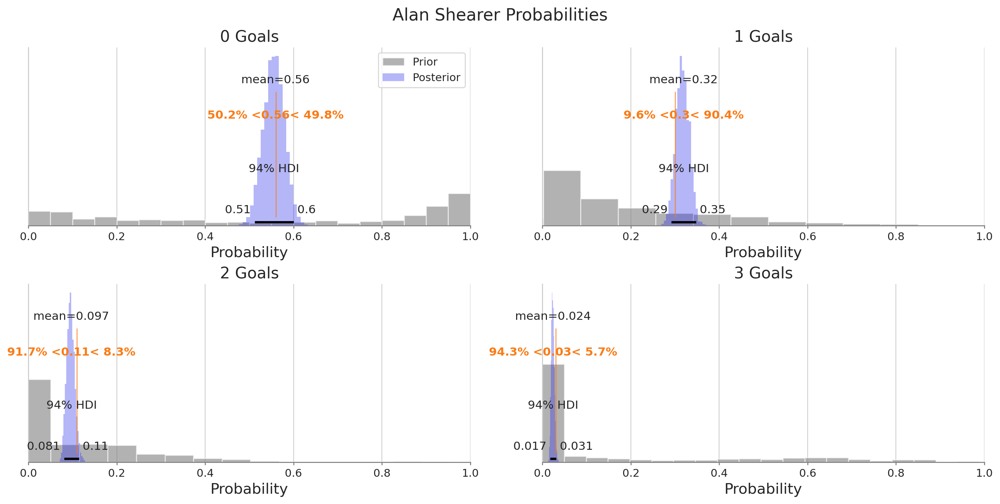

In [61]:
PLAYER = "alan shearer"
player_probs_prior = az.extract(idata.prior, var_names="goals_scored_probs").sel(
    name_player=PLAYER
)
player_probs_post = idata.posterior["goals_scored_probs"].sel(name_player=PLAYER)
empirics = (
    idata.observed_data.sel(name_player=PLAYER)["goals_scored"]
    .to_pandas()
    .value_counts(normalize=True)
)

_, axes = plt.subplots(2, 2, figsize=(14, 7), layout="constrained")
axes = axes.flatten()

for i, ax in enumerate(axes):
    ax.hist(
        player_probs_prior.sel(event=i).mean("obs_id"),
        color="grey",
        ec="white",
        bins=20,
        alpha=0.6,
        label="Prior",
    )
    az.plot_posterior(
        player_probs_post.sel(event=i).mean("obs_id"),
        label="Posterior",
        ax=ax,
        ref_val=empirics[i].round(2),
        textsize=11,
        kind="hist",
        bins=20,
    )
    ax.set(xlabel="Probability", yticklabels="", title=f"{i} Goals", xlim=[0, 1])
    ax.set_yticks([])
    sns.despine()
    if i == 0:
        ax.legend(fontsize=11, frameon=True)
plt.suptitle(f"{PLAYER.title()} Probabilities", fontsize=17);

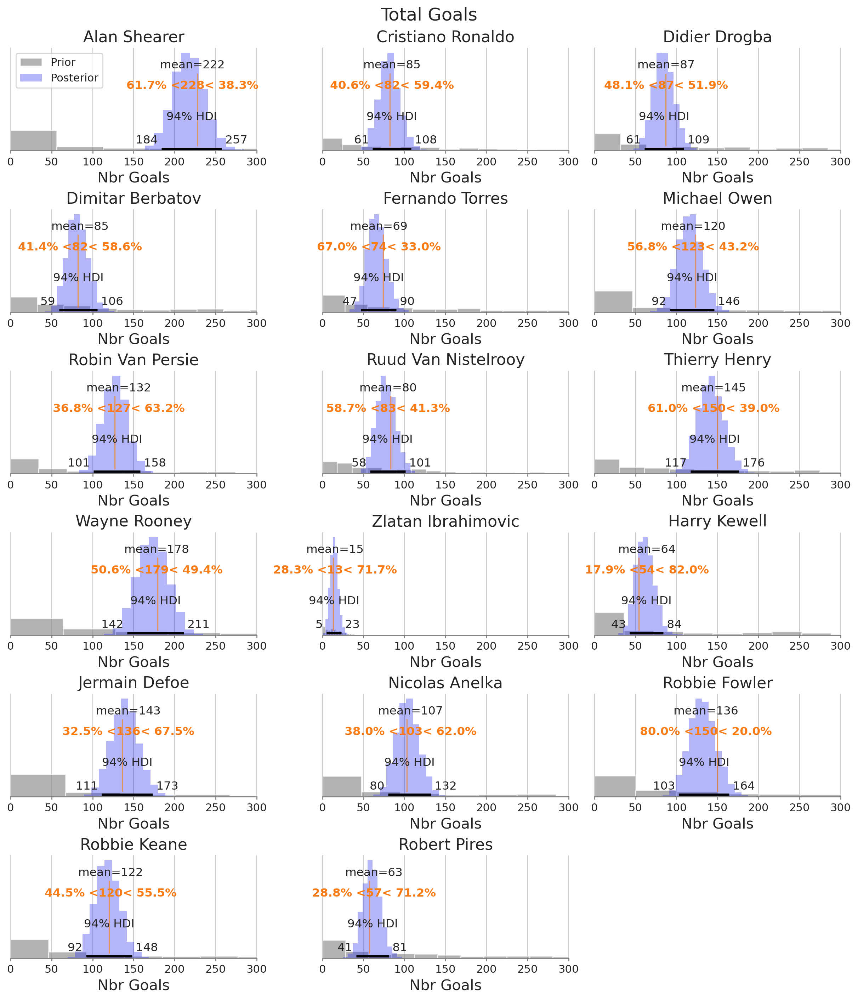

In [62]:
_, axes = plt.subplots(6, 3, figsize=(12, 14), layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    goals_prior = (
        az.extract(idata.prior_predictive, var_names="goals_scored")
        .sel(name_player=player)
        .sum("obs_id")
    )
    goals_post = (
        idata.posterior_predictive["goals_scored"].sel(name_player=player).sum("obs_id")
    )
    empirics = (
        idata.observed_data.sel(name_player=player)["goals_scored"].to_pandas().sum()
    )

    ax.hist(goals_prior, color="grey", ec="white", bins=20, alpha=0.6, label="Prior")
    az.plot_posterior(
        goals_post, label="Posterior", ax=ax, ref_val=empirics, textsize=11
    )
    ax.set(xlabel="Nbr Goals", yticklabels="", title=f"{player.title()}", xlim=[0, 300])
    ax.set_yticks([])
    sns.despine()
    if i == 0:
        ax.legend(fontsize=11, frameon=True)
plt.suptitle("Total Goals", fontsize=18);

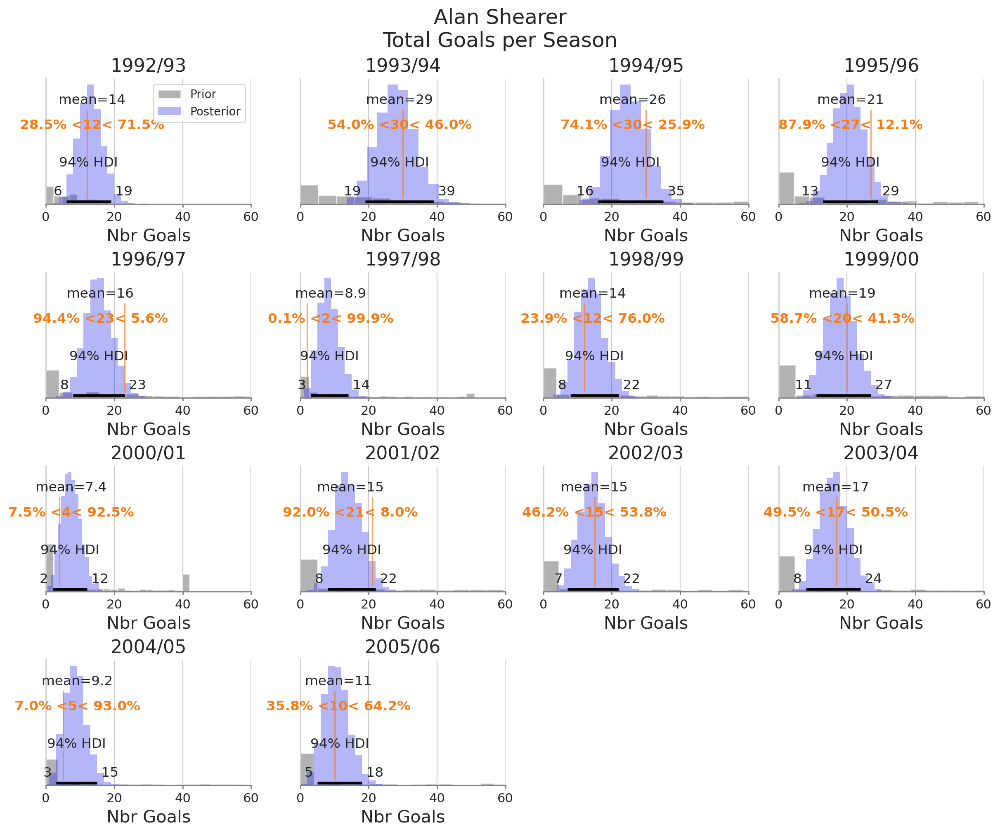

In [63]:
PLAYER = "alan shearer"
goals_prior = (
    az.extract(idata.prior_predictive, var_names="goals_scored")
    .sel(name_player=PLAYER)
    .groupby("season")
    .sum("obs_id")
)
goals_post = (
    idata.posterior_predictive["goals_scored"]
    .sel(name_player=PLAYER)
    .groupby("season")
    .sum("obs_id")
)
empirics = (
    idata.observed_data.sel(name_player=PLAYER)["goals_scored"]
    .to_pandas()
    .reset_index(name="goals")
    .groupby("season")
    .sum()["goals"]
)

unique_seasons = np.unique(goals_prior.season)
num_seasons = len(unique_seasons)

cols = 4
rows = (num_seasons + cols - 1) // cols

fig, axes = plt.subplots(rows, cols, figsize=(12, 2.5 * rows), layout="constrained")
axes = axes.flatten()

for season, (i, ax) in zip(unique_seasons, enumerate(axes)):
    ax.hist(
        goals_prior.sel(season=season),
        color="grey",
        ec="white",
        bins=20,
        alpha=0.6,
        label="Prior",
    )
    az.plot_posterior(
        goals_post.sel(season=season),
        label="Posterior",
        ax=ax,
        ref_val=empirics[season],
        textsize=11,
    )
    ax.set(xlabel="Nbr Goals", yticklabels="", title=f"{season}", xlim=[0, 60])
    ax.set_yticks([])
    sns.despine()
    if i == 0:
        ax.legend(fontsize=10, frameon=True)

# remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle(f"{PLAYER.title()}\nTotal Goals per Season", fontsize=18);

## Excess-Skill Metric

Therefore, let's have alook at the **excess-skill-metric** $S_{i,s}$. It compares each player's probability of scoring ($\hat{p}_{i,s}$) when accounting for both his ability and his team's strength ($\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}$) to the probability of him scoring when only accounting for his own skill/ability ($\hat{\alpha}_{i,s}$):

 $$ S_{i,s} = \frac{\frac{e^{\hat{\alpha}_{i,s}}}{1 \; + \; e^{\hat{\alpha}_{i,s}}}}{\frac{e^{\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}}}{1 \; + \; e^{\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}}}} \quad ,$$

where $S_{i,s} > 1$ tells us that -- according to the model -- **the player's scoring probability was dragged down by his team's performance**. Said differently, **player $i$'s full potential did not come through** while playing for that particular team in season $s$.


<br>

Since we already have stored the estimates for the numerator in `Player_Skill_season`, the only thing that is left to compute $S_{i,s}$ is the denominator.

To estimate the full model ( $\hat{\alpha}_{i,s} + \mathbf{X}_{i,s} \, \hat{\beta}$ ), we could again draw all our parameter-samples from the posterior via `trace_multi.posterior` and simulate some predictions ($\hat{p}_{i,s}$) using our observed factors $\mathbf{X}_{i,s}$. But that sounds like a lot of manual work ...

<br>

... **but with [#PyMC](https://www.pymc.io/welcome.html) it's pretty easy!** The `trace_multi.posterior["p_score"]` array has already got everything what we are looking for, namely the denominator in $S_{i,s}$.

<br>

Awesome! Let's compute our $S_{i,s}$ statistic as described above:

In [94]:
with SFM_rlp:
    pm.set_data(
        {"factor_data": np.zeros(idata.constant_data.factor_data.shape)},  # all teams are equal
    )

In [95]:
with SFM_rlp:
    perf_alone = pm.sample_posterior_predictive(
        idata,
        var_names=["goals_scored_probs"],
        compile_kwargs={"mode": "NUMBA"},
    )

Sampling: []


Output()

In [98]:
perf_alone.posterior_predictive = perf_alone.posterior_predictive.rename({"goals_scored_probs_dim_3": "event"})
perf_alone.posterior_predictive = perf_alone.posterior_predictive.assign_coords(mindex_coords)

In [103]:
prob_alone = 1 - perf_alone.posterior_predictive["goals_scored_probs"].sel(event=0)
prob_with_team = 1 - idata.posterior["goals_scored_probs"].sel(event=0)
s_metric = prob_alone / prob_with_team

<br>

So let's plot $S_{i,s}$, i.e. player $i$'s *excess-skill* in season $s$!

<br>

> Recall: $\,$ if $S_{i,s} > 1$ -- accordng to the model -- the player is *under-valued* compared to his inherent skill/ability, <br> &emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&emsp;&ensp; i.e. the player actually has **excess skill** but his own team is dragging him down.

In [105]:
filtered_seasons = complete_data.groupby("season")["name_player"].nunique().ge(3)
seasons_with_at_least_three_players = filtered_seasons[filtered_seasons].index

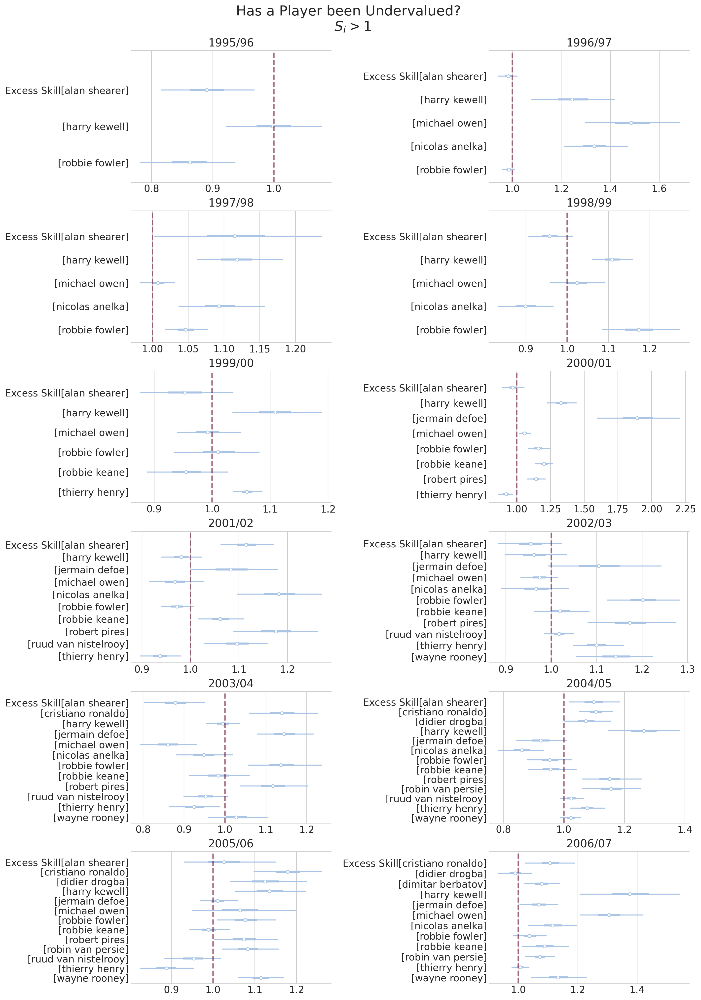

In [112]:
_, axes = plt.subplots(6, 2, figsize=(14, 20), layout="constrained")
axes = axes.ravel()

for ax, season in zip(axes, seasons_with_at_least_three_players):
    s_per_season = (
        s_metric.sel(season=season).groupby("name_player").mean("obs_id").rename("Excess Skill")
    )
    az.plot_forest(s_per_season, combined=True, ax=ax, colors="#AAC4E6")
    ax.set_title(season)
    ax.axvline(x=1, color="#70133A", alpha=0.6, ls="--", lw=2)

plt.suptitle("Has a Player been Undervalued? \n $S_{i} > 1$", fontsize=20);

<br>

But it could also be interesting to look **across seasons**! <br>
Let's just apply a summary metric (naturally the *mean* or *median*) on $S_{i,s}$ (where $S_{i,s}$ itself is either the *mean* or *median* of samples from the posterior distribution) across $s$, and get $S_{i}$, i.e. player $i$'s *excess-skill* across all seasons $s$.

In [115]:
s_across_seasons = s_metric.groupby("name_player").mean("obs_id").rename("Excess Skill")

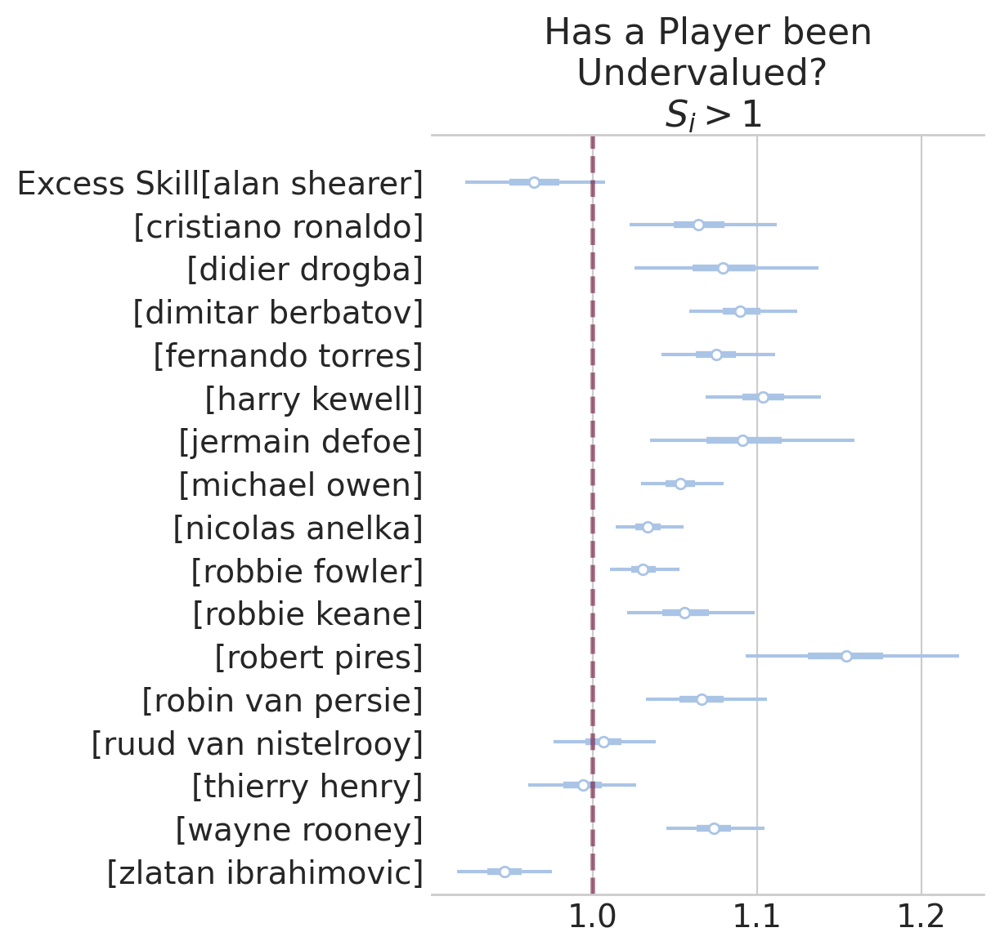

In [116]:
ax = az.plot_forest(s_across_seasons, combined=True, colors="#AAC4E6")
ax[0].set_title("Has a Player been Undervalued? \n $S_{i} > 1$")
ax[0].axvline(x=1, color="#70133A", alpha=0.6, ls="--", lw=2);

To recap again: the purpose of $S_{i}$ or $S_{i,s}$ is to evaluate how a  player's probability of scoring only based on his skill/ability, $\; P\left(Y_{i,s} | \hat{\alpha}_i \right) \;$, compares to the probability of him scoring when we also account for his team's strength, $\; P\left(Y_{i,s} | \mathbf{X}_{i,s}\, , \hat{\alpha}_i \, , \hat{\beta} \right) \;$. <br>
Keep in mind that we have built these metrics based on the posterior distribution's *median* (or the *mean*) -- hence, a single point-estimate only. We haven't said anything about the uncertainty around that single number.

## Performance evolution through time

### Gaussian Process on day-of-season

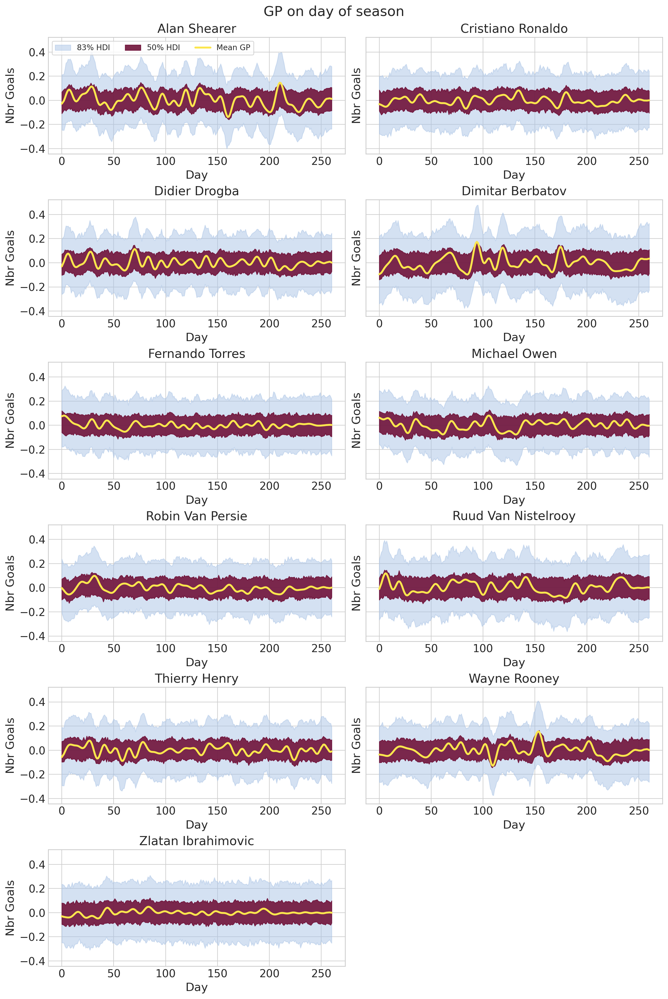

In [117]:
f_post = idata.posterior["f_season_effect_elite"]

_, axes = plt.subplots(6, 2, figsize=(12, 18), sharey=True, layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(f_post.elite.to_numpy(), enumerate(axes)):
    dates = f_post.sel(elite=player)["day"]
    y_plot = f_post.sel(elite=player)
    az.plot_hdi(
        x=dates,
        y=y_plot,
        hdi_prob=0.83,
        color="#AAC4E6",
        fill_kwargs={"alpha": 0.5, "label": r"$83\%$ HDI"},
        ax=ax,
        smooth=False,
    )
    az.plot_hdi(
        x=dates,
        y=y_plot,
        hdi_prob=0.5,
        color="#70133A",
        fill_kwargs={"alpha": 0.9, "label": r"$50\%$ HDI"},
        ax=ax,
        smooth=False,
    )
    ax.plot(
        dates, y_plot.mean(("chain", "draw")), color="#FBE64D", lw=2.5, label="Mean GP"
    )
    ax.set(xlabel="Day", ylabel="Nbr Goals", title=f"{player.title()}")
    if i == 0:
        ax.legend(fontsize=10, frameon=True, ncols=3)
plt.suptitle("GP on day of season", fontsize=18);

### Goal Probabilities per Season

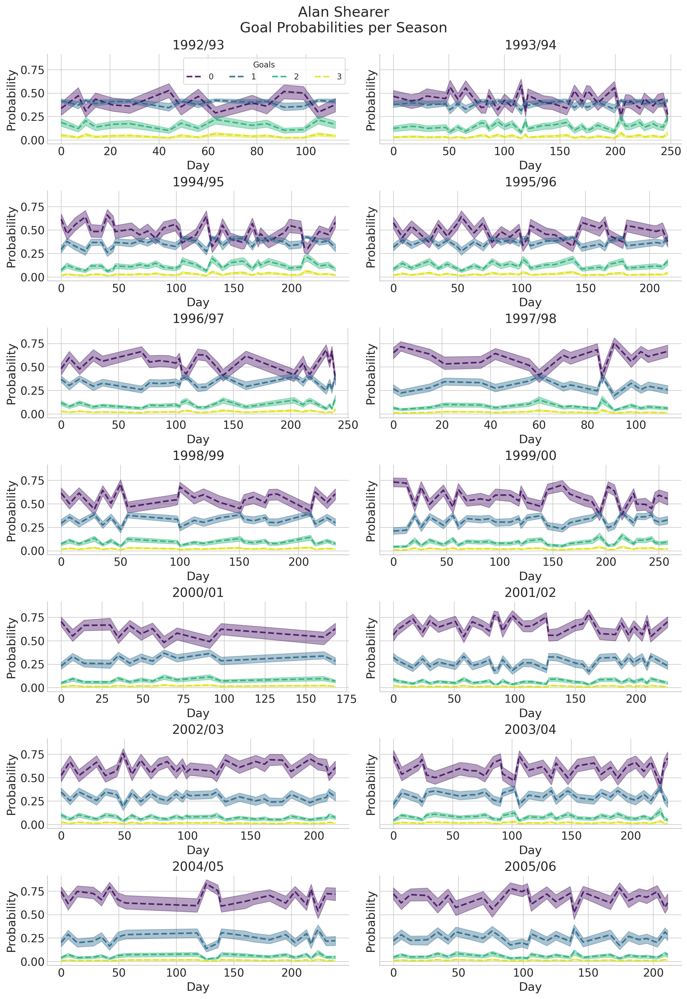

In [118]:
PLAYER = "alan shearer"
player_probs_post = idata.posterior["goals_scored_probs"].sel(name_player=PLAYER)
colors = plt.cm.viridis(np.linspace(0.05, 0.95, len(coords["event"])))

cols = 2
rows = (num_seasons + cols - 1) // cols

fig, axes = plt.subplots(
    rows, cols, figsize=(12, 2.5 * rows), layout="constrained", sharey=True
)
axes = axes.flatten()

for season, (i, ax) in zip(unique_seasons, enumerate(axes)):
    dates = player_probs_post.sel(season=season)["days_since_first_game"]
    y_plot = player_probs_post.sel(season=season)

    for event in player_probs_post.event.to_numpy():
        az.plot_hdi(
            x=dates,
            y=y_plot.sel(event=event),
            hdi_prob=0.75,
            color=colors[event],
            fill_kwargs={"alpha": 0.4},
            ax=ax,
            smooth=False,
        )
        ax.plot(
            dates,
            y_plot.sel(event=event).mean(("chain", "draw")),
            lw=2,
            ls="--",
            label=f"{event}",
            color=colors[event],
            alpha=0.9,
        )

    ax.set(xlabel="Day", ylabel="Probability", title=f"{season}")
    sns.despine()
    if i == 0:
        ax.legend(fontsize=10, frameon=True, title="Goals", ncols=4)

# remove any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.suptitle(f"{PLAYER.title()}\nGoal Probabilities per Season", fontsize=18);

### Counterfactuals Generation

In [119]:
max_nbr_games = (
    complete_data.groupby(["name_player", "season_nbr"])
    .count()["days_since_first_game"]
    .max()
)
last_game = complete_data["days_since_first_game"].max()
games_per_season = np.linspace(0, last_game, max_nbr_games, dtype=int)

index = pd.MultiIndex.from_product(
    [players_ordered, complete_data["season_nbr"].unique(), games_per_season],
    names=["player", "season_nbr", "day"],
)
unique_combinations = pd.DataFrame(index=index).reset_index()

In [120]:
with SFM_rlp:
    pm.set_data(
        coords={"obs_id": unique_combinations.index},
        new_data={
            "seasons": unique_combinations["season_nbr"].to_numpy(),
            "day_id": pd.Categorical(
                unique_combinations["day"],
                categories=days,
            ).codes,
            "player_id": pd.Categorical(
                unique_combinations["player"], categories=players_ordered
            ).codes,
            "factor_data": np.zeros(
                (len(unique_combinations), len(factors))
            ),  # all teams are equal
            "goals_obs": np.zeros(
                len(unique_combinations), dtype=int
            ),  # just a placeholder for shape inference
        },
    )

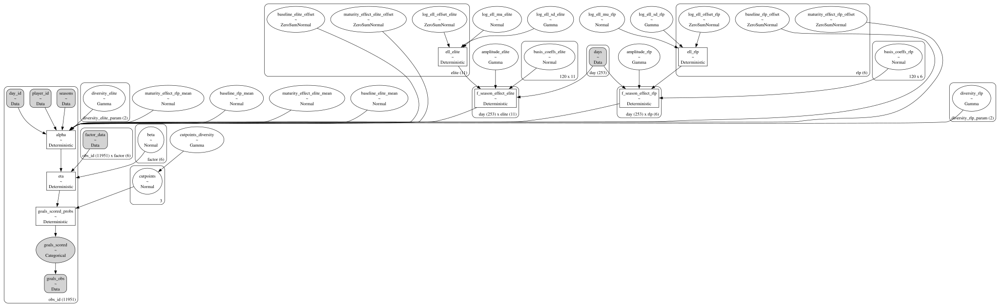

In [121]:
pm.model_to_graphviz(SFM_rlp)

In [122]:
with SFM_rlp:
    preds = pm.sample_posterior_predictive(
        idata,
        var_names=["alpha", "goals_scored_probs", "goals_scored"],
        predictions=True,
        compile_kwargs={"mode": "NUMBA"},
    )

/Users/alex_andorra/mambaforge/envs/football-models/lib/python3.11/site-packages/pytensor/link/numba/dispatch/basic.py:381: UserWarning: Numba will use object mode to run AdvancedSubtensor's perform method
  warnings.warn(
Sampling: [goals_scored]


Output()

In [124]:
preds.predictions = preds.predictions.rename({"goals_scored_probs_dim_3": "event"})

# declare the Multiindex as coordinates
mindex_coords = xr.Coordinates.from_pandas_multiindex(index, "obs_id")

# pass it as coordinates
preds.predictions = preds.predictions.assign_coords(mindex_coords)
preds.predictions_constant_data = preds.predictions_constant_data.assign_coords(
    mindex_coords
)
preds.predictions

<xarray.Dataset> Size: 2GB
Dimensions:             (chain: 4, draw: 1000, obs_id: 11951, event: 4)
Coordinates:
  * chain               (chain) int64 32B 0 1 2 3
  * draw                (draw) int64 8kB 0 1 2 3 4 5 ... 994 995 996 997 998 999
  * event               (event) int64 32B 0 1 2 3
  * obs_id              (obs_id) object 96kB MultiIndex
  * player              (obs_id) object 96kB 'alan shearer' ... 'robert pires'
  * season_nbr          (obs_id) int64 96kB 0 0 0 0 0 0 0 ... 18 18 18 18 18 18
  * day                 (obs_id) int64 96kB 0 7 14 21 28 ... 231 238 245 252 260
Data variables:
    alpha               (chain, draw, obs_id) float64 382MB 0.5737 ... 1.17
    goals_scored        (chain, draw, obs_id) int64 382MB 1 0 1 0 1 ... 1 1 0 2
    goals_scored_probs  (chain, draw, obs_id, event) float64 2GB 0.5915 ... 0...
Attributes:
    created_at:                 2024-06-24T19:14:22.023743+00:00
    arviz_version:              0.18.0
    inference_library:          pymc
    inference_library_version:  5.15.1+31.gf44071bd

### Scoring Probabilities

In [125]:
n_seasons = complete_data.groupby(["name_player"])["season"].nunique().sort_values()
probs_preds = az.extract(preds.predictions, var_names="goals_scored_probs")
dates = np.unique(probs_preds["season_nbr"].to_numpy())
player_data = (
    complete_data.groupby(["name_player", "season_nbr"])["goal"]
    .value_counts(normalize=True)
    .sort_index()
    .reset_index(level=[1, 2])
)
player_data = player_data[player_data.goal == 1].drop("goal", axis=1)

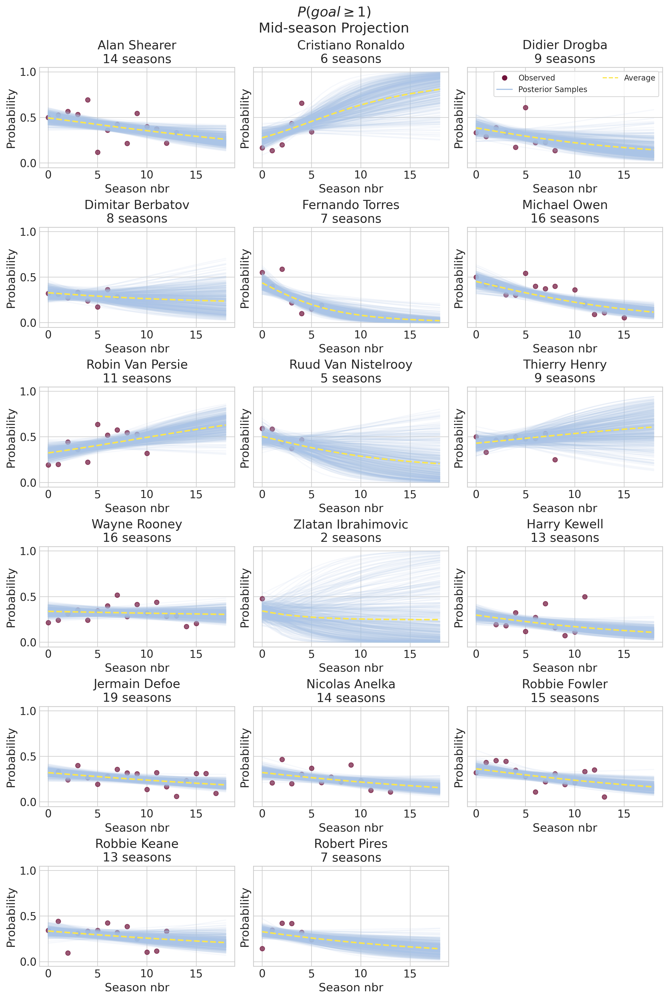

In [126]:
_, axes = plt.subplots(6, 3, figsize=(12, 18), sharey=True, layout="constrained")
axes = axes.flatten()
axes[-1].remove()

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    player_scoring_prob = 1 - probs_preds.sel(player=player, event=0).groupby(
        "season_nbr"
    ).mean("obs_id")

    ax.plot(
        dates,
        player_scoring_prob.sel(sample=slice(None, None, 10)),
        color="#AAC4E6",
        alpha=0.1,
    )
    ax.plot(dates, player_scoring_prob.mean("sample"), color="#FBE64D", lw=2, ls="--")
    ax.scatter(
        player_data.loc[player, "season_nbr"],
        player_data.loc[player, "proportion"],
        color="#70133A",
        alpha=0.7,
    )

    ax.set(
        title=f"{player.title()}\n{n_seasons.loc[player]} seasons",
        xlabel="Season nbr",
        ylabel="Probability",
    )
    if i == 2:
        handles = [
            Line2D(
                [], [], color="#70133A", marker="o", linestyle="None", label="Observed"
            ),
            Line2D([], [], color="#AAC4E6", label="Posterior Samples"),
            Line2D([], [], color="#FBE64D", ls="--", label="Average"),
        ]
        ax.legend(handles=handles, fontsize=10, frameon=True, ncols=2)

plt.suptitle("$P(goal \geq 1)$\nMid-season Projection", fontsize=18);

### Scoring Rates

Compute expected goals per match for each posterior sample (assuming 3+ goals is treated as exactly 3 goals).

In [127]:
expected_goals = (
    (
        1 * preds.predictions.sel(event=1)
        + 2 * preds.predictions.sel(event=2)
        + 3 * preds.predictions.sel(event=3)
    )["goals_scored_probs"]
    .unstack("obs_id")
    .rename("expected_goals")
)
player_data = complete_data.set_index("name_player")

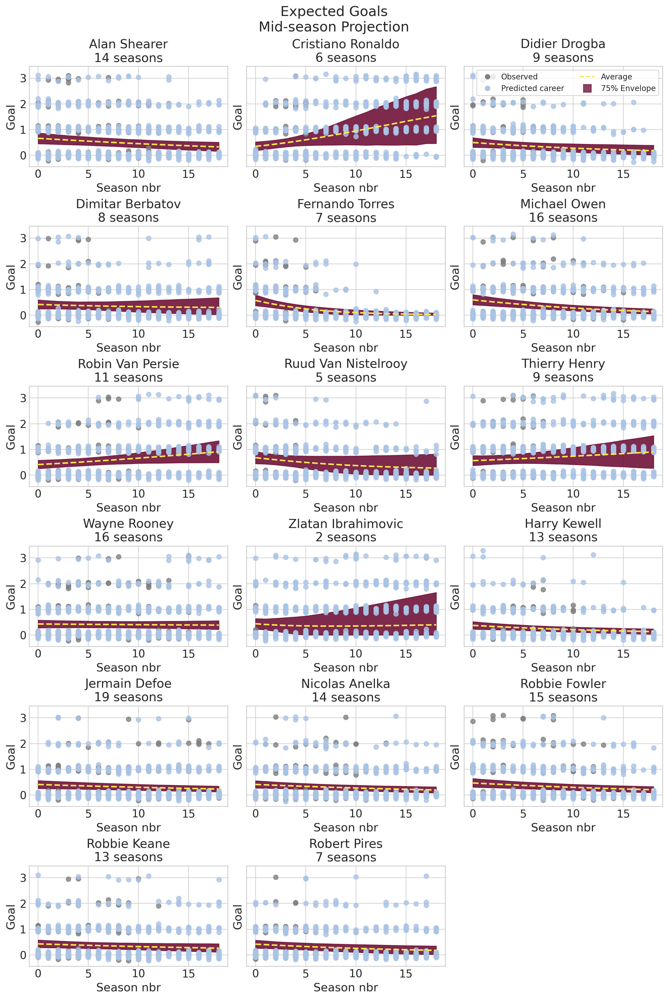

In [128]:
_, axes = plt.subplots(6, 3, figsize=(12, 18), sharey=True, layout="constrained")
axes = axes.flatten()
axes[-1].remove()
jitter_strength = 0.07

for player, (i, ax) in zip(players_ordered, enumerate(axes)):
    player_scoring_rate = expected_goals.sel(player=player)
    player_preds = az.extract(preds.predictions.sel(player=player))["goals_scored"].sel(
        sample=(
            rng.choice(preds.predictions.chain),
            rng.choice(preds.predictions.draw),
        ),
    )

    ax.plot(
        player_preds["season_nbr"],
        player_preds + rng.normal(0, jitter_strength, player_preds.shape),
        marker="o",
        linestyle="None",
        color="#AAC4E6",
        alpha=0.8,
    )
    az.plot_hdi(
        dates,
        hdi_data=az.hdi(
            player_scoring_rate, input_core_dims=[["chain", "draw", "day"]]
        ),
        hdi_prob=0.75,
        ax=ax,
        smooth=False,
        color="#70133A",
        fill_kwargs={"alpha": 0.9},
    )
    ax.plot(
        dates,
        player_scoring_rate.mean(["chain", "draw", "day"]),
        color="#FBE64D",
        lw=2,
        ls="--",
    )
    ax.scatter(
        player_data.loc[player, "season_nbr"],
        player_data.loc[player, "goals_cats"]
        + rng.normal(0, jitter_strength, len(player_data.loc[player, "goals_cats"])),
        c="grey",
        alpha=0.8,
    )

    ax.set(
        title=f"{player.title()}\n{n_seasons.loc[player]} seasons",
        xlabel="Season nbr",
        ylabel="Goal",
    )
    if i == 2:
        handles = [
            Line2D(
                [], [], color="grey", marker="o", linestyle="None", label="Observed"
            ),
            Line2D(
                [],
                [],
                color="#AAC4E6",
                marker="o",
                linestyle="None",
                label="Predicted career",
            ),
            Line2D([], [], color="#FBE64D", ls="--", label="Average"),
            Line2D(
                [],
                [],
                color="#70133A",
                alpha=0.8,
                marker="s",
                markersize=10,
                linestyle="None",
                label="75% Envelope",
            ),
        ]
        ax.legend(handles=handles, fontsize=10, frameon=True, ncols=2)

plt.suptitle("Expected Goals\nMid-season Projection", fontsize=18);

## PAR Analysis

In [129]:
post_preds = idata.posterior_predictive.reset_index("obs_id")
rlp_perf = post_preds["goals_scored"].where(
    post_preds["name_player"].isin(coords["rlp"]), drop=True
)
elite_perf = post_preds["goals_scored"].where(
    post_preds["name_player"].isin(coords["elite"]), drop=True
)
par = (
    elite_perf.groupby("name_player").mean("obs_id") - rlp_perf.mean("obs_id")
).rename("PAR")

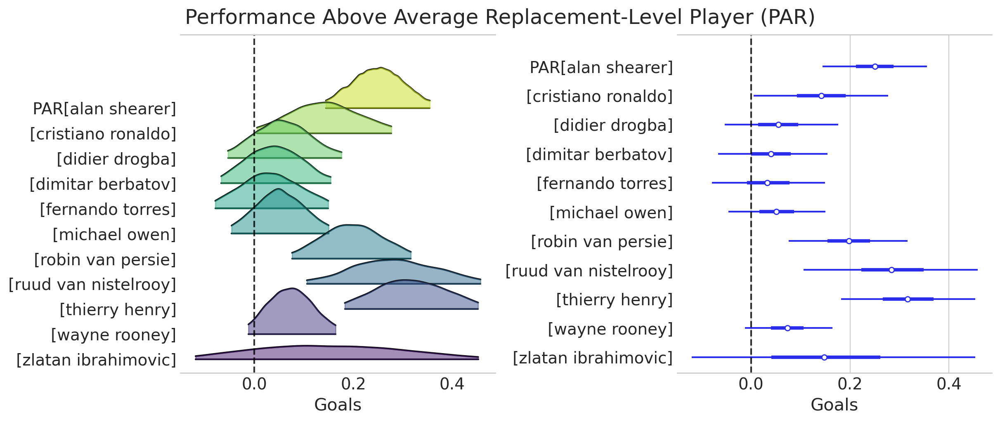

In [130]:
_, (left, right) = plt.subplots(1, 2, sharex=True)
az.plot_forest(
    par,
    combined=True,
    kind="ridgeplot",
    ridgeplot_overlap=1.5,
    ridgeplot_alpha=0.5,
    ax=left,
)
colors = sns.color_palette("viridis", n_colors=len(coords["elite"]))
# adjust colors manually
for patch, color in zip(left.collections, colors):
    patch.set_color(color)
left.axvline(c="k", ls="--", alpha=0.8)
left.set(title="", xlabel="Goals")

az.plot_forest(par, combined=True, ax=right)
right.axvline(c="k", ls="--", alpha=0.8)
right.set(title="", xlabel="Goals")
plt.suptitle("Performance Above Average Replacement-Level Player (PAR)", fontsize=18);

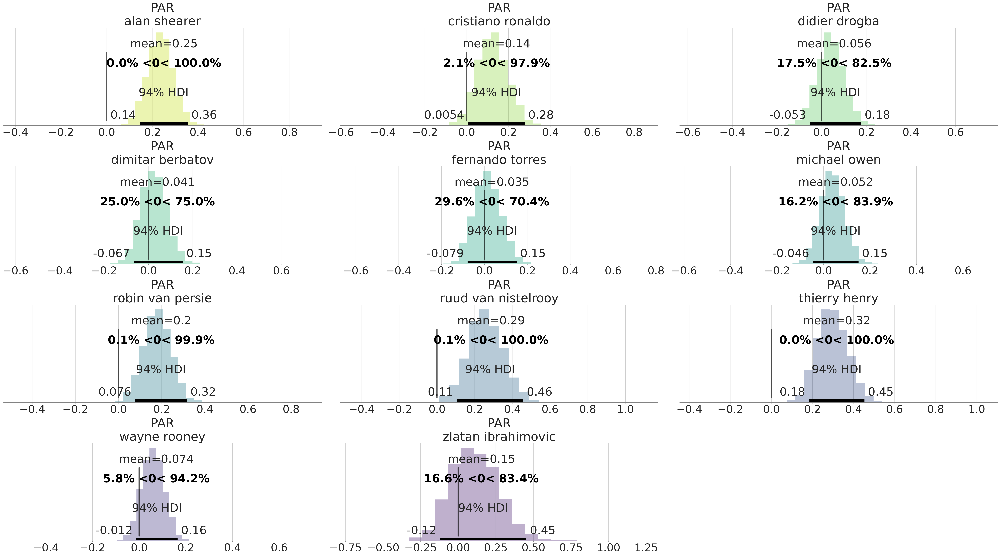

In [131]:
axes = az.plot_posterior(
    par,
    kind="hist",
    round_to=2,
    grid=(4, 3),
    textsize=32,
    ref_val=0,
    ref_val_color="k",
)

# customize bar colors
for ax, color in zip(axes.flatten(), colors[::-1]):
    for bar in ax.patches:
        bar.set_facecolor(color)

## TO DO: 3D plot

## Packages versions

In [132]:
%load_ext watermark
%watermark -n -u -v -iv -w

Last updated: Mon Jun 24 2024

Python implementation: CPython
Python version       : 3.11.9
IPython version      : 8.22.2

matplotlib: 3.8.4
xarray    : 2024.3.0
pandas    : 2.2.2
arviz     : 0.18.0
pytensor  : 2.22.1
seaborn   : 0.13.2
pymc      : 5.15.1+31.gf44071bd
numpy     : 1.26.4

Watermark: 2.4.3

